<a href="https://colab.research.google.com/github/Danish-H/edge-content-reconstruction/blob/main/batch_image_reconstruction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Installing Dependencies

In [ ]:
!pip install -q diffusers==0.14.0 xformers transformers scipy ftfy accelerate controlnet_aux
!pip install -q "jax[cuda12_pip]==0.4.23" -f https://storage.googleapis.com/jax-releases/jax_cuda_releases.html
!pip install -q opencv-contrib-python controlnet_aux image-similarity-measures
!pip install -q gradio open_clip_torch clip-interrogator
!pip install -q openai

In [ ]:
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel, UniPCMultistepScheduler
from image_similarity_measures.evaluate import evaluation
from diffusers.utils import load_image
from PIL import Image

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os, subprocess
import numpy as np
import torch
import glob
import cv2

# Connect Google Drive (Optional)

This cell assumes `images_dataset.zip` is placed in the root of your Google Drive.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

!cp /content/drive/MyDrive/images_dataset.zip /content/
!unzip -q images_dataset.zip

# Generate Prompts using CLIP

The following cells prepare and generate prompts from the extracted images using CLIP. Special thanks to *@pharmapsychotic* for [their notebook](https://colab.research.google.com/github/pharmapsychotic/clip-interrogator/blob/main/clip_interrogator.ipynb).

In [ ]:
caption_model_name = 'blip-large' #@param ["blip-base", "blip-large", "git-large-coco"]
clip_model_name = 'ViT-L-14/openai' #@param ["ViT-L-14/openai", "ViT-H-14/laion2b_s32b_b79k"]

import gradio as gr
from clip_interrogator import Config, Interrogator

config = Config()
config.clip_model_name = clip_model_name
config.caption_model_name = caption_model_name
ci = Interrogator(config)

def image_analysis(image):
    image = image.convert('RGB')
    image_features = ci.image_to_features(image)

    top_mediums = ci.mediums.rank(image_features, 5)
    top_artists = ci.artists.rank(image_features, 5)
    top_movements = ci.movements.rank(image_features, 5)
    top_trendings = ci.trendings.rank(image_features, 5)
    top_flavors = ci.flavors.rank(image_features, 5)

    medium_ranks = {medium: sim for medium, sim in zip(top_mediums, ci.similarities(image_features, top_mediums))}
    artist_ranks = {artist: sim for artist, sim in zip(top_artists, ci.similarities(image_features, top_artists))}
    movement_ranks = {movement: sim for movement, sim in zip(top_movements, ci.similarities(image_features, top_movements))}
    trending_ranks = {trending: sim for trending, sim in zip(top_trendings, ci.similarities(image_features, top_trendings))}
    flavor_ranks = {flavor: sim for flavor, sim in zip(top_flavors, ci.similarities(image_features, top_flavors))}

    return medium_ranks, artist_ranks, movement_ranks, trending_ranks, flavor_ranks

def image_to_prompt(image, mode):
    ci.config.chunk_size = 2048 if ci.config.clip_model_name == "ViT-L-14/openai" else 1024
    ci.config.flavor_intermediate_count = 2048 if ci.config.clip_model_name == "ViT-L-14/openai" else 1024
    image = image.convert('RGB')
    if mode == 'best':
        return ci.interrogate(image)
    elif mode == 'classic':
        return ci.interrogate_classic(image)
    elif mode == 'fast':
        return ci.interrogate_fast(image)
    elif mode == 'negative':
        return ci.interrogate_negative(image)

Loading caption model blip-large...
Loading CLIP model ViT-L-14/openai...
Loaded CLIP model and data in 8.25 seconds.


there is a horse that is looking out of a stable, by Dicky Doyle, black clouds, news photography, highly polished, tyrant, muscled, highly relaxed, detention centre, with a gullet at the end, open windows, brown stubble, labelled, midlands, dredged seabed, dreamwave, impressive winning photo, acanthus, leonid


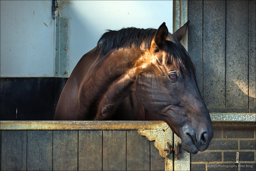

Generating prompts:  67%|██████▋   | 101/150 [18:14<09:43, 11.91s/it]

an old photo of a mushroom cloud in the sky, top - down photograph, wearing correct era clothes, studio trigger, modern setting, photo still of interior, ethnicity : japanese, doomsday, real life picture, unbroken, cgi render, mid - 3 0 s aged, front page, 4 2 0, ash


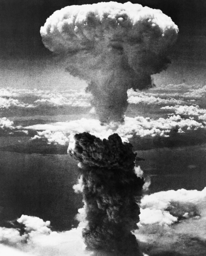

Generating prompts:  68%|██████▊   | 102/150 [18:27<09:44, 12.18s/it]

arafed view of a stadium with a green field and a lot of buildings, ornate french architecture, greta thunberg, large triangular shapes, white buildings with red roofs, konami, exterior photo, live broadcast, features between french, arena, panasonic, wing


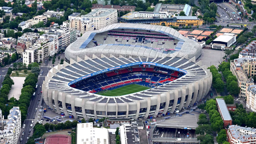

Generating prompts:  69%|██████▊   | 103/150 [18:37<09:01, 11.52s/it]

there are many people standing in a room with suits on, his arms are behind his back, high energy, black and white style, a palace with a thousand long, portrait hd, by Gregory Gillespie, photo from a spectator, the darkest hour, walking away, classified photo, best photography of 2 0 2 1, 2 0 1 9, warrior, a stock photo


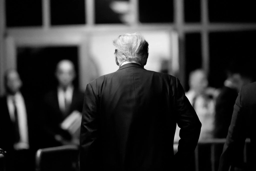

Generating prompts:  69%|██████▉   | 104/150 [18:50<09:09, 11.94s/it]

there is a large building with a clock on the front of it, african iconography, karachi skyline background, in a large cathedral, wide-angle lens vanishing point, 21:9, on a sunny day, front view 2 0 0 0, restored color, french features, front closeup, file photo, arcade, fully frontal view


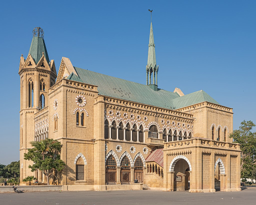

Generating prompts:  70%|███████   | 105/150 [19:02<08:58, 11.96s/it]

there is a bee that is sitting on a flower in the field, 2 0 2 1 cinematic 4 k framegrab, unsplash photography, by Bikash Bhattacharjee, lorem ipsum dolor sit amet, video art, mustard, symmetric wings, spring evening, best photography of 2 0 2 1, by Wang Yi


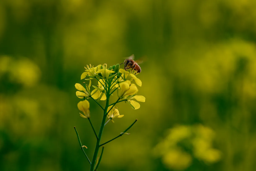

Generating prompts:  71%|███████   | 106/150 [19:11<08:12, 11.19s/it]

araffe cloud in the sky with a horse grazing in the foreground, crewson photography, sunset panorama, cumulonimbus, an australian summer landscape, albuquerque, getty images, on a canva, multiple layers, southern california, by David G. Sorensen, empyrean city, full width


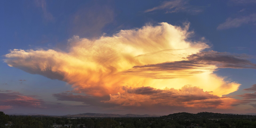

Generating prompts:  71%|███████▏  | 107/150 [19:22<07:52, 10.99s/it]

there is a jet flying in the sky with contrails behind it, f 3 5 fighter, polished : :, widescreen shot, inspired by Li Tang, pictured from the shoulders up, flares anamorphic, trending on getty, smoke :6, hovering drone, featuring rhodium wires, sharply shaped


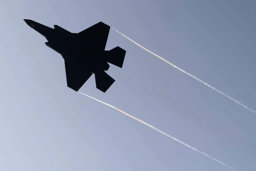

Generating prompts:  72%|███████▏  | 108/150 [19:32<07:33, 10.79s/it]

arafed view of the earth from space showing the pacific and australia, ray - tracing radiosity, redshift renderer, green and purple color scheme, discord profile picture, centered full-body shot, timelapse, rendered in redshift, ad image, blue marble, tonemapping, left align, group portrait


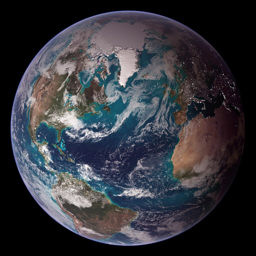

Generating prompts:  73%|███████▎  | 109/150 [19:43<07:23, 10.81s/it]

arafed view of a train with blue seats and yellow railings, unsplash photography, the scary empty liminal spaces, metro 2 0 3 3, anamorphic widescreen, trending on pixabay, public bus, narrow face, 1128x191 resolution, brass wheels, a ghetto in germany, empty office, underground party, pixabay


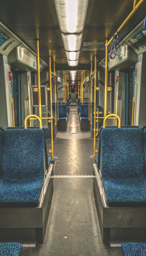

Generating prompts:  73%|███████▎  | 110/150 [19:55<07:28, 11.22s/it]

astronaut standing on the moon with american flag in hand, the best modern photo of august, production photo, bruh moment, inspired by Andries Both, banner, epic stance, old color photograph, 50 years old, 4 2 0, historical photograph, spoiler, may 6 8, highres, praise the sun, design thinking


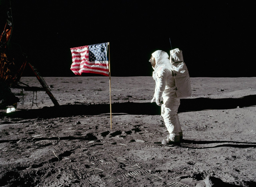

Generating prompts:  74%|███████▍  | 111/150 [20:08<07:40, 11.81s/it]

there are many red berries on a branch with green leaves, cgrender, isolated white background, hasanabi, elder, ash falling, images on the sales website, identical picture, casting spell, reduce duplication, face shown, reconstruction, november


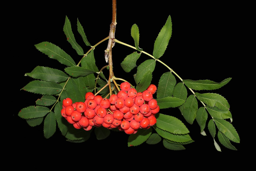

Generating prompts:  75%|███████▍  | 112/150 [20:18<07:08, 11.29s/it]

araffe spewing water from a hole in the ground, unsplash photography, horizon of an erupting volcano, geysers of steam, scene from the voice of america, reflecting pool, half - length photo, horn, telephoto vacation picture, symatrical


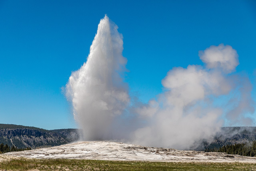

Generating prompts:  75%|███████▌  | 113/150 [20:26<06:22, 10.32s/it]

three penguins walking in the snow near a mountain with a glacier behind them, widescreen shot, photo of the middle of the ocean, parks and monuments, journalistic photo, seen from the long distance, clear skies, standing in midground, mattepainting


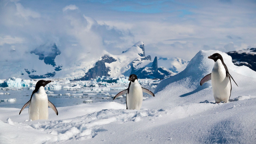

Generating prompts:  76%|███████▌  | 114/150 [20:34<05:46,  9.63s/it]

a close up of a computer motherboard with many electronic components, behance. high detail, samsung smartthings, blue image, creative commons attribution, executive industry banner, triangle shards, sharp smooth focus, high definition photograph, prototype, mcu photograph


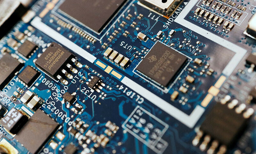

Generating prompts:  77%|███████▋  | 115/150 [20:43<05:29,  9.41s/it]

araffes in a field with a fence and a fence in the foreground, award - winning photo. ”, rolling green hills, 21:9, 8k hq, sheer cliffs surround the scene, san mumford, by Paul Davis, canva, diffuse subsurface scattering, first light, creative commons attribution, horizon view, cypresses


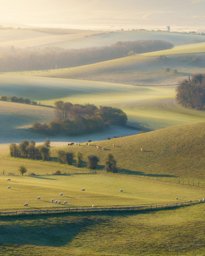

Generating prompts:  77%|███████▋  | 116/150 [21:00<06:34, 11.61s/it]

panda bear sitting on a tree branch with red and green trees in the background, still from avengers endgame, by Zhang Shuqi, bashful expression, hybrid animal, posing in disguise among humans, basil, white with black spots, bbc earth, 1 0 0 0 mm, 21:9, worried


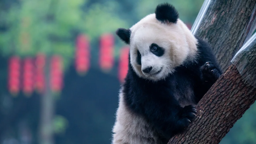

Generating prompts:  78%|███████▊  | 117/150 [21:10<06:08, 11.17s/it]

there is a bonsai tree that is in a pot on a table, unsplash 4k, a large sphere of red energy, pink flower, by Daren Bader, an scp anomalous object, the empress’ swirling gardens, ominous dark background, magical aesthetics, laurels of glory, scary pines


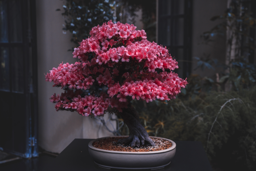

Generating prompts:  79%|███████▊  | 118/150 [21:23<06:14, 11.71s/it]

the moon is seen during a solar eclipse in the sky, wearing gold glasses, timelapse, smiley profile, view from a news truck, profile picture 1024px, within radiate connection, banner, bright neon solar flares, cardboard, uzumaki, in savannah, clear edges, at midday, shot from game of thrones


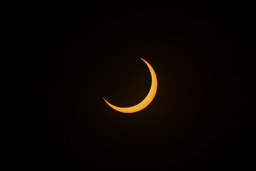

Generating prompts:  79%|███████▉  | 119/150 [21:36<06:10, 11.94s/it]

there is a large body of water with waves in the middle, in rough seas with large waves, 40nm, short depth of field, nord, silver and blue color schemes, photo taken from a boat, widescreen shot, school of fishes, full width, april, flat texture, sails


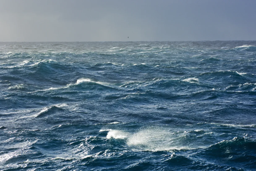

Generating prompts:  80%|████████  | 120/150 [21:46<05:47, 11.60s/it]

there is a half of an apple and a half of an apple, yellow backdrop, imagenet, size difference, pespective, mutant, high resolution product photo, creative commons attribution, r / vexilology, colour led, an open book, two different characters, hi-fructose, p cattaneo, golden pommel, with grey skin, sharpened image


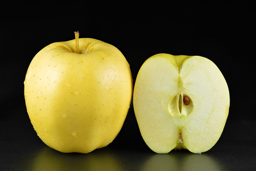

Generating prompts:  81%|████████  | 121/150 [22:00<05:51, 12.11s/it]

there is a bench sitting on the side of the road by the water, unsplash photography, floor lamps, blue sea. by makoto shinkai, aspect ratio 16:9, summer clear blue sky, nouvelle vague, inspired by Giorgio de Chirico, holiday resort, lakeside, unsplash


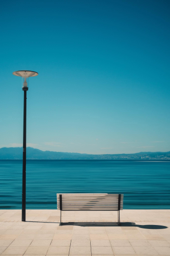

Generating prompts:  81%|████████▏ | 122/150 [22:09<05:16, 11.29s/it]

arafed view of a stadium with a large stadium sign on it, fc barcelona, airborne view, low res, amateur photo, awestruck, els, national geograph, day after raining, unedited, hammers, high elevation, 2000, front photo, amateur photograph


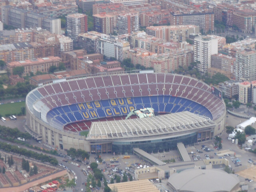

Generating prompts:  82%|████████▏ | 123/150 [22:21<05:08, 11.43s/it]

arafed view of a city with a full moon in the sky, los angeles, icy mountains, trending on 500px, sunset!, back to us, 21:9, inspired by Malcolm Morley, spring season city, stunning!, wide-screen, 2 0 2 2 photo, sous la pleine lune, by Thomas Cornell, today\'s featured photograph 4k


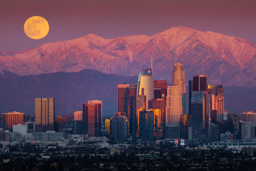

Generating prompts:  83%|████████▎ | 124/150 [22:34<05:07, 11.84s/it]

arafed hand in a glove holding a syet in a rack of vials, photo taken with nikon d750, panoramic anamorphic, kodachrome colour, brown and pink color scheme, before the final culling, ai researcher, defocused bars in the foreground, by Juan Villafuerte, morph dna


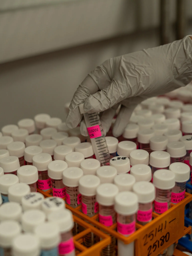

Generating prompts:  83%|████████▎ | 125/150 [22:42<04:33, 10.93s/it]

arafed rocket with smoke and smokestacks is taking off, elon musk as slimy mollusk, getty images, duck themed spaceship, florida, by Ben Enwonwu, long distance shot, canon- 70-200mm lens, ue6, editors choice, photograph credit: ap, smooth vector curves, sci - ci, on


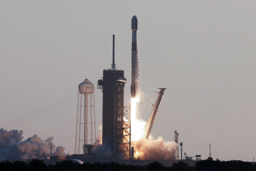

Generating prompts:  84%|████████▍ | 126/150 [22:54<04:27, 11.16s/it]

arafed pasta with spinach and cheese in a bowl with a spoon, trending on unsplash, sealed super joe biden, by Keren Katz, trending on dezeen, golden goddess athena, intense albino, hunter biden, pollock photorealistic, by Caroline Mytinger, healthy


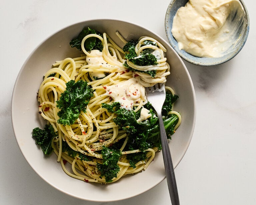

Generating prompts:  85%|████████▍ | 127/150 [23:03<04:01, 10.50s/it]

there is a close up of a lion's face with a very big mane, unsplash 4k, piercing glare in the eyes, iphone screenshot, shot on anamorphic lenses, battle scar, by Jeff A. Menges, featured on unsplash, inspired by Jerry Pinkney, seductive gaze, battle - weary


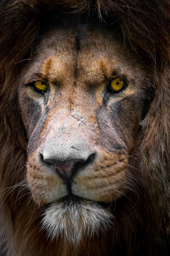

Generating prompts:  85%|████████▌ | 128/150 [23:13<03:44, 10.21s/it]

there is a cat that is hiding under a blanket, trending on unsplash, discord profile picture, by Tim Biskup, obi-wan kenobi, eyes open in wonder, wearing pointed hoods, l · lawliet, in the early morning, jinsung lim


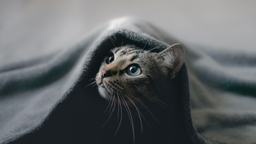

Generating prompts:  86%|████████▌ | 129/150 [23:22<03:30, 10.02s/it]

araffe train on the tracks with mountains in the background, enterprise workflow engine, canada, featured on cg society, compass energy flowing, long flowing fins, red cloud, exterior photography, checkerboard horizon, photographed for reuters, panoramic shot, michael margetts, paul carrick


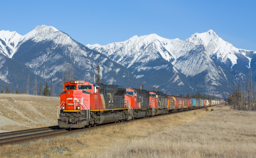

Generating prompts:  87%|████████▋ | 130/150 [23:33<03:27, 10.38s/it]

arafed race driver in a red bull racing suit and helmet, 2019 trending photo, mexican warrior, trending on textures. com, passionate pose, face of an ox, steel collar, celebration, sacrifice, daniel oxford, hunting buffalo, dolphin snout under visor, puṣkaracūḍa, sky - fi


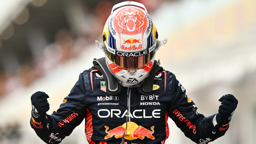

Generating prompts:  87%|████████▋ | 131/150 [23:46<03:28, 10.99s/it]

arafed cabin in the snow with a green aurora behind it, “derelict architecture buildings, wlop : :, unsplash photography, image credit nat geo, nuclear aftermath, inspired by Nikolai Ge, antique renewal, glittering ice, photographed, by Aloysius O'Kelly, unearthly


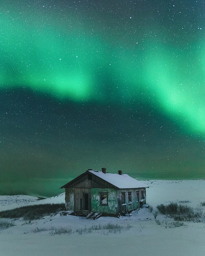

Generating prompts:  88%|████████▊ | 132/150 [23:59<03:29, 11.63s/it]

there is a large airplane flying through the clouds in the sky, depth of field background, pale yellow sky, taken with a canon eos 5 d, surface blemishes, character is flying, grey shift, traverse, staggered depth, float, travellers, descent, white machinery


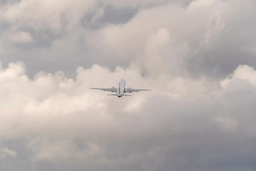

Generating prompts:  89%|████████▊ | 133/150 [24:10<03:13, 11.38s/it]

arafly looking train on the tracks with cherry trees in the background, gold and luxury materials, marketing photo, purple energy, inspired by Junpei Satoh, in 2 0 1 8, brown paper, breathtaking scenery, promotional photograph


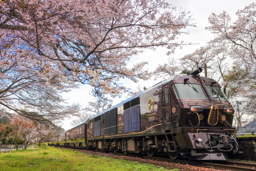

Generating prompts:  89%|████████▉ | 134/150 [24:17<02:44, 10.27s/it]

there are two street signs on top of a stop sign, spring colors, washington, by Sylvia Wishart, stygian, alain aslan, upscale, behance. polished, honeysuckle, bentonville arkansas, beautiful!!!!!!!!!, by Gregory Gillespie, red blush, header, lush paradise, sylas, sbt, swan, in a hood, live


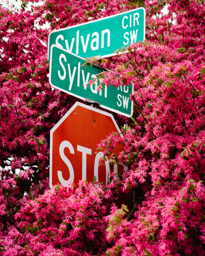

Generating prompts:  90%|█████████ | 135/150 [24:34<03:03, 12.26s/it]

a close up of a water faucet with a drop of water coming out of it, cosmic lsd poster art, rasta, an amazing photo, inspired by Margaret Bruce Wells, by Scott Gustafson, water in background, beautiful spectrum of vibrancy, leaking, brown water, amazing shot, stream flowing through the house


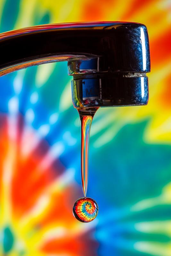

Generating prompts:  91%|█████████ | 136/150 [24:44<02:42, 11.62s/it]

there is a lone tree in the foreground of a farm, new hampshire, picture of a loft in morning, unsplash photography, silent hill in real life, beautiful!!!! museum photo, inspired by James Montgomery Flagg, james yang, cinematic widescreen shot, by Mathieu Le Nain


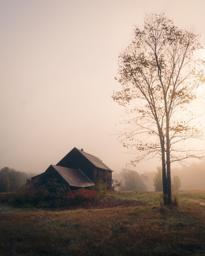

Generating prompts:  91%|█████████▏| 137/150 [24:53<02:18, 10.62s/it]

there are four squares of colored glass on a white wall, microsoft windows logo, condensation droplet render, logopond, right - half a cheerful face, made of drink, justify contents center, oily high relief, reduce duplication interference, a brightly colored, extremely luminous bright design


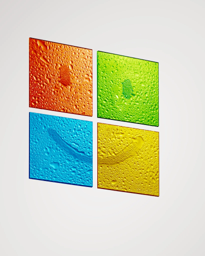

Generating prompts:  92%|█████████▏| 138/150 [25:02<02:02, 10.18s/it]

there is a tiger walking down a dirt road in the woods, centered full-body shot, marking lines, by Bholekar Srihari, pictured from the shoulders up, sleek spines, crew cut, side view of her taking steps, full profile, resplendent


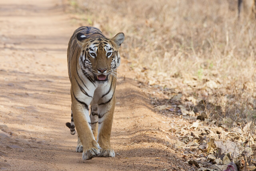

Generating prompts:  93%|█████████▎| 139/150 [25:10<01:45,  9.61s/it]

arafed statue of liberty holding a torch in her hand, profile picture 1024px, featured, woman holding sign, view from below, close-up photography, humanization, across holding a hand, imposing, patriot, 2 d depth map, standing together, face shown


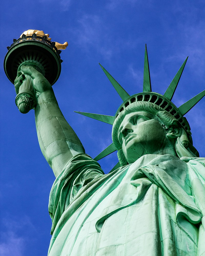

Generating prompts:  93%|█████████▎| 140/150 [25:21<01:38,  9.88s/it]

there is a bird sitting on a branch of a tree, unsplash photography, 🌸 🌼 💮, by Sadamichi Hirasawa, aspect ratio 16:9, sparrows, pinterest anime, sakura bloomimg, brown tail, award-winning magazine photo, suki, by Jason Teraoka, twitter, good night, plain red background, kawai


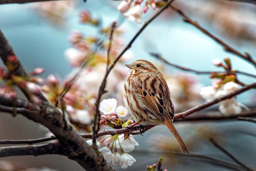

Generating prompts:  94%|█████████▍| 141/150 [25:38<01:49, 12.18s/it]

there is a brown horse standing in a field with mountains in the background, trending on unsplash, boris johnson hairstyle, remote icelandic village, fluffy tail, vox machina, half horse - half mouse, glamour fashion pose, fjords, roaming the colony, unsplash photography, golden - ratio, unsplash


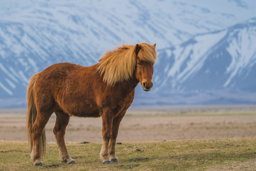

Generating prompts:  95%|█████████▍| 142/150 [25:50<01:36, 12.05s/it]

there is a windmill that is sitting in the grass, lorem ipsum dolor sit amet, dutch style, gettyimages, skeuomorphic, overall architectural design, twitch streamer, vertical orientation, quirky 1 9 th century, scoia'tael), mill, european face


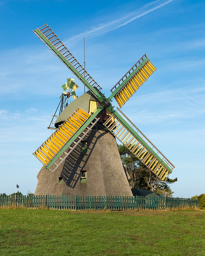

Generating prompts:  95%|█████████▌| 143/150 [25:59<01:19, 11.29s/it]

there is a red box and a black hose in a room, workshop background, by Dirk Helmbreker, “gas station photography, clock, high resolution print :1 red, curated collection, connected to wires, auto and design magazine, blue wall, square, social realism


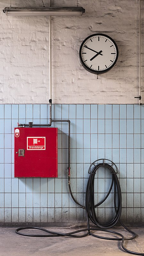

Generating prompts:  96%|█████████▌| 144/150 [26:12<01:10, 11.69s/it]

arafed view of the earth from space with a satellite in the foreground, florida, panoramic anamorphic, tone mapping, very beautiful!! aerial shot, the wonder of devotion, connectedness, ue marketplace, humanoid pov, black sea, high definition photo, the argo, cgsociety - n 5, ui


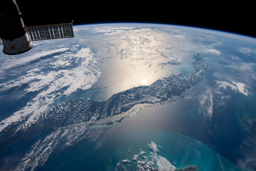

Generating prompts:  97%|█████████▋| 145/150 [26:24<00:58, 11.67s/it]

there is a dog that is sitting in the snow, anamorphic bokeh and lens flares, mystic sheperd, realistic maya, in profile, hyper - detailed color photo, animatic, inspired by Gloria Stoll Karn, extremely detailed fur, tessgarman, by Siona Shimshi, shallan davar, sam


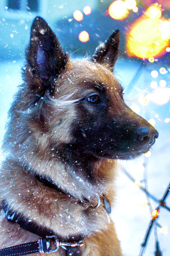

Generating prompts:  97%|█████████▋| 146/150 [26:34<00:45, 11.33s/it]

there are many red flowers that are growing in the field, unsplash photography, killed in war, glowing delicate flower, creative commons attribution, sony a 7 iii, poppy, metamorphose, ( golden hour ), photostock


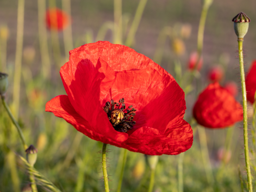

Generating prompts:  98%|█████████▊| 147/150 [26:44<00:32, 10.80s/it]

arafed red bull racing car with a man standing on top of it, trending on unsplash, caesar victorious, angel versus devil, arms held high in triumph, size difference, miami, award-winning oil painting, black and red, colossus, logos, historic moment, on his right hand, the boys, kda


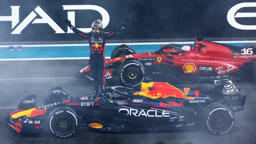

Generating prompts:  99%|█████████▊| 148/150 [26:56<00:22, 11.31s/it]

brightly colored building with a flag on top and a blue sky, in the style wes anderson, !dream los angeles, ffffound, saatchi art, by Barbara Nessim, the palms come from the depths, stalinist architecture, oceanside, hand - tinted, the empress’ swirling gardens, hotel, thisset colours


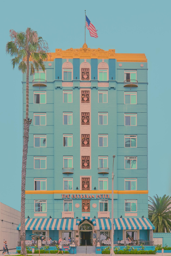

Generating prompts:  99%|█████████▉| 149/150 [27:09<00:11, 11.62s/it]

a close up of a eclipse of light in the dark sky, neon pink and black color scheme, the ring, associated press photography, crown of white diamonds, journalistic photography, lensflares, maroon mist, flowing pink-colored silk, sun in the zenith, collapse


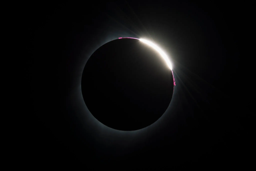

Generating prompts: 100%|██████████| 150/150 [27:18<00:00, 10.92s/it]





Generated 150 prompts and saved to /content/images_dataset/desc.csv, enjoy!


In [ ]:
#@title Batch generate prompts

import csv
import os
from IPython.display import clear_output, display
from PIL import Image
from tqdm import tqdm

folder_path = "/content/images_dataset" #@param {type:"string"}
prompt_mode = 'best' #@param ["best","fast","classic","negative"]
output_mode = prompts_clip.csv #@param string
max_filename_len = 128 #@param {type:"integer"}


def sanitize_for_filename(prompt: str, max_len: int) -> str:
    name = "".join(c for c in prompt if (c.isalnum() or c in ",._-! "))
    name = name.strip()[:(max_len-4)] # extra space for extension
    return name

ci.config.quiet = True

files = [f for f in os.listdir(folder_path) if f.endswith('.jpg') or f.endswith('.png') or f.endswith('.JPG') or f.endswith('.jpeg') or f.endswith('.JPEG') or f.endswith('.webp')] if os.path.exists(folder_path) else []
prompts = []
prompts_dict = {}
for idx, file in enumerate(tqdm(files, desc='Generating prompts')):
    if idx > 0 and idx % 100 == 0:
        clear_output(wait=True)

    image = Image.open(os.path.join(folder_path, file)).convert('RGB')
    prompt = image_to_prompt(image, prompt_mode)
    prompts.append(prompt)

    print(prompt)
    thumb = image.copy()
    thumb.thumbnail([256, 256])
    display(thumb)

    if output_mode == 'rename':
        name = sanitize_for_filename(prompt, max_filename_len)
        ext = os.path.splitext(file)[1]
        filename = name + ext
        idx = 1
        while os.path.exists(os.path.join(folder_path, filename)):
            print(f'File {filename} already exists, trying {idx+1}...')
            filename = f"{name}_{idx}{ext}"
            idx += 1
        os.rename(os.path.join(folder_path, file), os.path.join(folder_path, filename))

if len(prompts):
    if output_mode == 'desc.csv':
        csv_path = os.path.join("./", 'desc.csv')
        with open(csv_path, 'w', encoding='utf-8', newline='') as f:
            w = csv.writer(f, quoting=csv.QUOTE_MINIMAL)
            w.writerow(['image', 'prompt'])
            for file, prompt in zip(files, prompts):
                w.writerow([file, prompt])
                prompts_dict[file] = prompt

        print(f"\n\n\n\nGenerated {len(prompts)} prompts and saved to {csv_path}, enjoy!")
    else:
        print(f"\n\n\n\nGenerated {len(prompts)} prompts and renamed your files, enjoy!")
else:
    print(f"Sorry, I couldn't find any images in {folder_path}")


# Generate Prompts using GPT-4

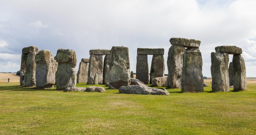

053.JPG 
 Mystical ancient stone circle {Stonehenge}, illuminated by soft sunlight, vast green fields in background, Photorealistic Image, golden ratio, 4K resolution, 35mm lens, medium shot, natural light


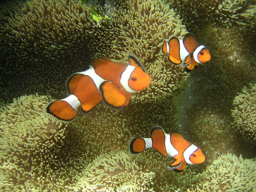

051.JPG 
 A pair of clownfish nestling amongst vibrant coral reefs, ultra-realistic underwater photograph, shot with a macro lens (135mm), showcasing intricate details and hyper detailed texture, natural light filtering through ocean water, soft light illuminating the scene, 8K resolution, high dynamic range (hdr:1.25)


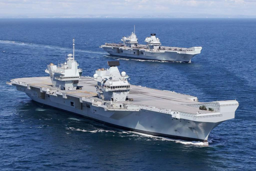

076.jpg 
 Two majestic aircraft carriers sailing side by side on a clear day, high resolution, realistic photograph, sunny weather with vivid blue ocean and clear sky, 70mm lens, front view, detailed reflection on water, HDR, 8K


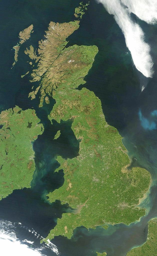

078.jpg 
 Aerial view of a verdant coastal landscape, resembling the British Isles, in a high-resolution photograph, 300mm wide angle lens, HDR lighting emphasizing the lush greens and deep blues of the sea, highly detailed texture of the land and water.


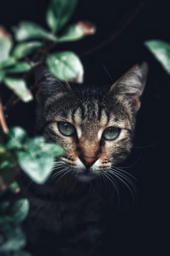

115.jpg 
 A close-up portrait of a majestic domestic cat peeking through lush green leaves, sharp focus, high resolution, soft natural light, with a deep green and black background – Photorealistic Image, digital photograph, shot with a macro lens (35mm), 8K, majestic and mysterious mood with detailed fur texture and gleaming eyes.


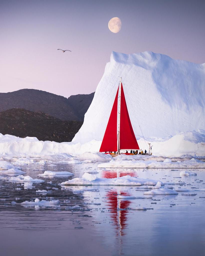

133.jpg 
 Red sailboat navigating through Arctic waters, with large icebergs and a full moon in the twilight sky, high resolution photograph, 35mm lens, soft twilight lighting, detailed reflection in calm water, back view, Arctic exploration theme.


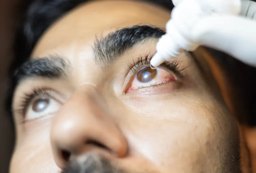

039.webp 
 Close-up shot of a person's eye being attended to meticulously by a healthcare worker, hyper-detailed, indoor setting with soft studio lighting emphasizing the textures and reflections on the eye, professional photography, 135mm lens, highly detailed with a focus on realism and clarity, ambient light (ambient light:1.2), high resolution


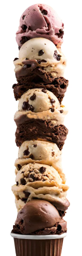

014.webp 
 A towering stack of various ice cream scoops including strawberry, vanilla with chocolate chips, and triple chocolate, balanced in a chocolate-dipped waffle cone, 4K hyper detailed image, Food Photography, Front view shot with a 35mm lens, natural light, featuring (high resolution:1.5) and(render style: cinematic)


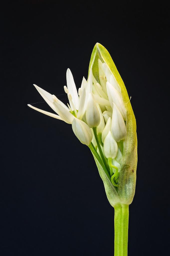

071.jpg 
 Close-up photograph of a blooming wild garlic flower, buds emerging vividly against a dark indigo background, crisp and clear with a sharp focus, 35mm lens, high resolution, natural sunlight highlighting the delicate textures of the petals and leaves.


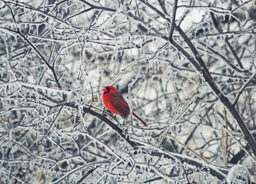

138.jpg 
 A male cardinal perched on a tree branch with ice-encased twigs, digital photograph, inspired by nature photography, medium telephoto lens, close-up shot, high resolution, detailed with natural soft light effects


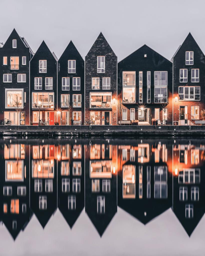

140.jpeg 
 Contemporary houses with sharp geometric designs reflected perfectly in calm waters at dusk, high resolution photograph, sharp focus with 35mm lens, front view, HDR effects, warm lights from windows adding a cozy, ambient feel


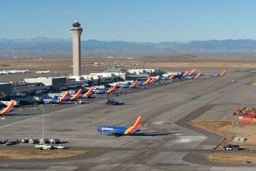

013.webp 
 Busy airport tarmac with multiple airplanes lined up, control tower overseeing the operations, clear sunny day, high resolution photograph, wide angle lens, natural light, (lens: 35mm), (hdr:1.25), background featuring distant mountains


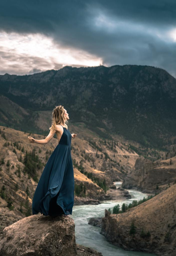

114.jpeg 
 Photorealistic Image: {A woman in an elegant blue dress stands poised on a rocky outcrop, her arms outstretched as if embracing the mountain wind}, Outdoor mountain landscape during sunset, high-definition, 35mm lens, low angle shot, detailed texture, HDR lighting, golden ratio composition


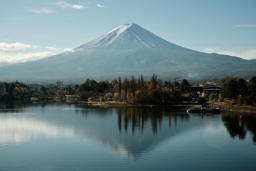

112.jpg 
 Majestic mountain overlooking a calm lake, early autumn morning with crisp air, visible soft sunrays enhancing the warm, faded colors of the foliage, High Resolution, Photorealistic Image, medium telephoto lens, close-up shot, HDR and highly detailed render


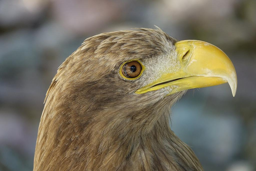

084.jpg 
 Majestic eagle with a sharp gaze, high resolution photograph, captured using a (35mm:1.2) lens, close-up shot, detailed feathers texture, natural light, in a wild forest setting


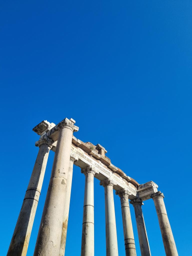

141.jpg 
 Ancient Greco-Roman columns standing tall against a clear blue sky, photorealistic image, high resolution, sharp focus, 35mm lens, low angle view, (details:1.2), perfectly capturing the texture of the stone and the intricate carvings, bathed in natural sunlight


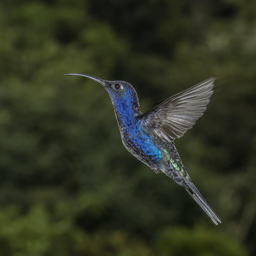

092.jpg 
 Vivid blue and green hummingbird in mid-flight, capturing the delicate motion of its wings, set against a soft-focus forest background, hyper-detailed photorealistic image, shot with a wide angle 35mm lens, high resolution rendering, natural sunlight filtering through leaves creating a dynamic interplay of light and shadow


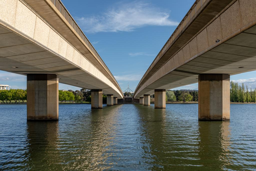

126.jpg 
 Modern architecture, expansive concrete bridge spanning peacefully over a tranquil river, with a clear sky and gentle ripples on water surface, Photorealistic Image, HDR, high resolution 8K, Camera lens 70mm, wide angle, low angle view, natural light (hyper detailed:1.18)


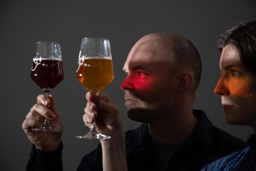

024.jpg 
 {two people toasting with elegant glasses of beer, a man with red light on his face, a woman looking towards the man}, indoor studio shot, muted ambient lighting, mid-telephoto lens:135mm, high resolution, realistic photograph


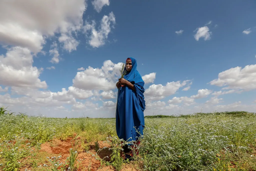

010.webp 
 An African woman wearing a blue garment standing in a vibrant green field, with a bright blue sky and fluffy white clouds overhead, 4K resolution, realistic photograph, Natural light, golden ratio composition, wide angle lens (35mm)


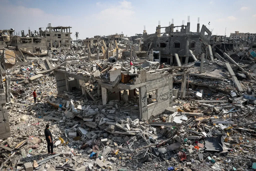

020.webp 
 Post-apocalyptic cityscape, Photorealistic Image, 35mm wide angle lens, high angle shot, HDR, 8K resolution


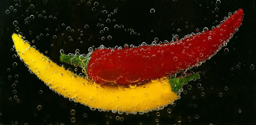

083.jpg 
 Two chili peppers, one red and one yellow, submerged in sparkling clear water with bubbles clinging to their surfaces, Type of image: photograph, Shot: close-up, Camera: macro lens, Render Related Information: 4K resolution, highly detailed, natural light reflecting off the water droplets


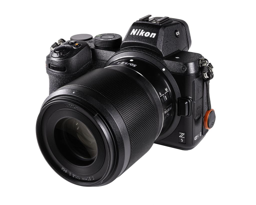

129.jpg 
 A professional DSLR camera, highly detailed and photorealistic, focus on the intricate design and materials, isolated on a solid white background. Camera: 135mm lens, sharp focus, high angle view. Resolution: 8K, Render: cinematic


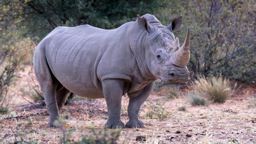

094.jpg 
 Photorealistic Images: {Majestic rhinoceros walking through a dry grassy savannah}, digital photograph, outdoor setting with subtle sunrays peeking through sparse trees, low angle view, camera lens 70mm, high resolution, (natural light:1.2), (detailed:1.15)


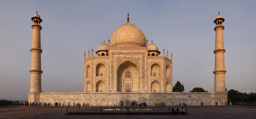

090.jpg 
 Taj Mahal at sunrise, high-resolution photograph, early morning light casting long shadows, with a serene sky, captured as a wide-angle shot from a (wide angle:1.5), vibrant colors, HDR detail, cinematic (Octane render:1.1)


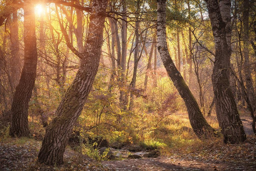

099.jpg 
 Enchanted autumn forest at sunrise with sunrays filtering through leaves, 4K high resolution, natural light, vivid colors, wide angle lens


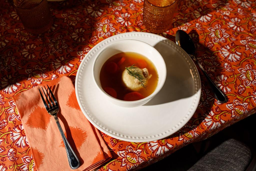

006.jpg 
 A steaming bowl of soup with a sprig of dill on top, resting on a vibrant orange and red floral tablecloth. An elegant white ceramic bowl and a neatly folded orange napkin beside it, with soft-focus utensils partially visible. Indoor setting with natural light casting dynamic shadows and highlights, giving a cozy, inviting atmosphere. Scene captured in a high-resolution digital photograph, using a 35mm lens.


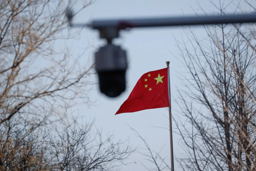

034.webp 
 Chinese flag waving briskly, typical winter day setting, Photorealistic Image, ultra-detailed 8K resolution, hdr lighting intensifying the vivid red and gold colors; camera: 300mm telephoto lens, shot: medium shot, lighting: natural light with sharp focus, inspired by classic National Geographic photography


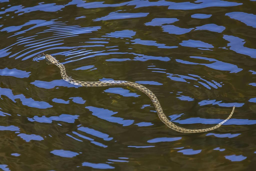

093.jpg 
 Photorealistic Image: {gray patterned water snake gliding silently over the dark, rippled lake water}, Type of Image: high-resolution photograph, Camera: 200mm telephoto lens, Shot: close-up, Render Related Information: natural light, high detail, (sunrays arriving softly on the lake:1.2)


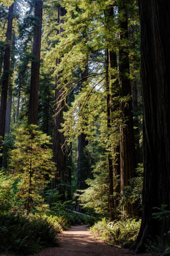

144.jpg 
 Sunlight filtering through the dense canopy of ancient redwood trees, photorealistic image, vibrant natural light, outdoor, high angle view, 35mm lens, natural light emphasis, highly detailed resolution


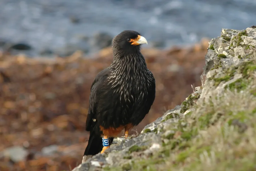

028.webp 
 Striated Caracara perched on a rocky coastline, high resolution digital photograph, lens: sharp focus 70mm, low angle view, HDR sunlight highlighting plumage details, background of blurred ocean waves and brown autumn leaves


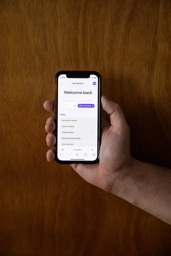

101.webp 
 A person's hand holding a smartphone, open to a chat app, details on screen readable, in an indoor setting with a wooden background, Photorealistic Images, high resolution, shot taken with a wide angle lens, soft natural light illuminating the hand and phone


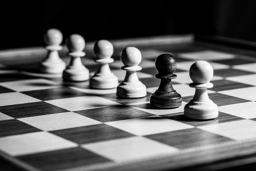

087.jpg 
 Chess pieces poised in mid-game, monochrome digital photograph, high-resolution, influenced by classic chess tournaments, EE 70mm lens, medium shot, studio lighting, (detailed:1.30), (hyper detailed:1.10)


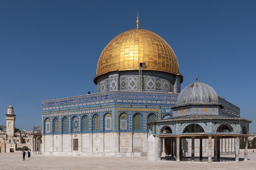

052.jpg 
 Dome of the Rock, breathtaking historical architecture, bright sunny day with deep blue sky, detailed Islamic tile work, Jerusalem, high-resolution digital photograph, UHD, 135mm lens, natural light, sharp focus


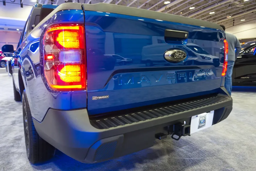

037.webp 
 Ford Maverick hybrid pickup truck from the rear, high-resolution photograph, parked outdoors during sunset with soft sunlight casting shadows, 35mm lens, focused on the logo and tail lights| Camera: wide angle


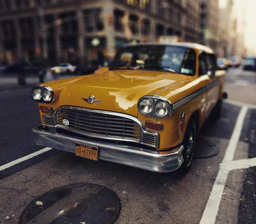

147.jpg 
 Vintage yellow taxi cab parked on a bustling New York street, realistic photograph, low angle shot, 35mm lens, high resolution, detailed city background with blurred pedestrians and modern buildings, sun rays coming through high-rise buildings, HDR, soft light


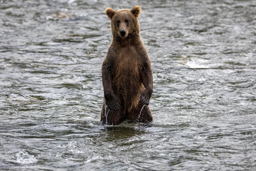

005.webp 
 Grizzly bear standing upright in a swiftly flowing river, Photorealistic Image, Close-up Shot, 200mm lens, High Detail, HDR, Ambient Natural Light, Rendered in Octane


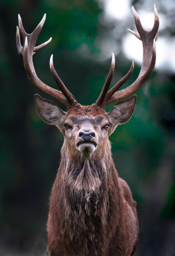

124.jpeg 
 Majestic stag with expansive antlers, outdoor forest setting, early morning mist, high resolution, 70mm lens, front view, natural light, detailed, 8K resolution


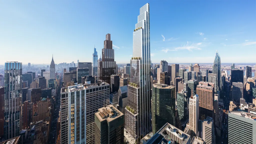

036.webp 
 Vibrant urban skyline, high-resolution digital photograph, modern architecture, skyscrapers reaching towards a clear blue sky, bustling city view, wide angle, shot with a sharp focus from a high angle, rendering with HDR and UHD details


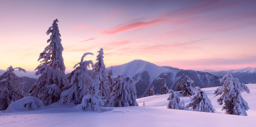

097.jpg 
 A breathtaking winter sunrise illuminating a frost-covered mountain landscape, snow-laden trees dominate the foreground, 8K resolution, professional photographic style, wide angle EE 70mm lens, sharp focus, high-detail capture, soft ambient sunlight casting golden hues, serene outdoor atmosphere, HDR for enhanced lighting dynamics


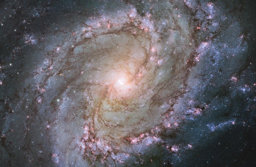

080.jpg 
 A majestic spiral galaxy, viewed in high resolution, with twinkling stars and radiant cosmic dust, Type of Image: digital illustration, Art Styles: surrealism, Art Inspirations: Hubble Space Telescope photos, Camera: wide angle lens, Shot: panoramic, Render Related Information: 8K resolution, highly detailed, HDR lighting


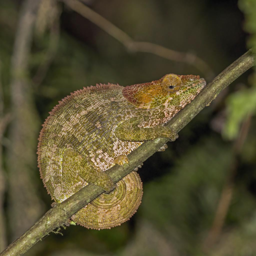

123.jpg 
 A highly detailed photorealistic image of a chameleon blending into a vibrant, green forest environment, perched on a branch; 4K resolution, hdr:1.25, shallow depth of field using a (macro lens:1.5), natural light with (sunrays:1.3) piercing through the canopy, close-up view


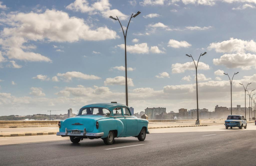

122.jpg 
 Vintage blue car driving on a sunlit city highway, skyscrapers in the background, realistic HDR photograph, 135mm lens, high angle, detailed rendering with emphasis on sunlight and shadow interplay (hdr:1.25), (detail:1.3)


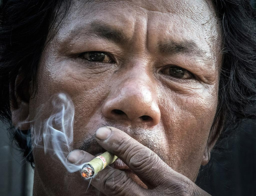

069.jpg 
 Close-up portrait of an elderly man smoking a cigar, focused on the detailed textures of his aged skin, the smoke swirling around, realistic photograph, 35mm lens, high resolution, detailed, natural light, front view


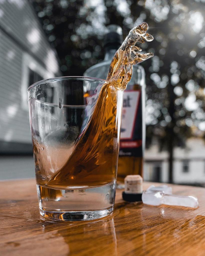

109.jpg 
 Whiskey being poured into a glass with ice cubes, realistic photograph, outdoor setting on a wooden table during sunset, vivid lighting with sunrays highlighting the splash, 70mm lens, low angle shot, detailed, HDR, high resolution


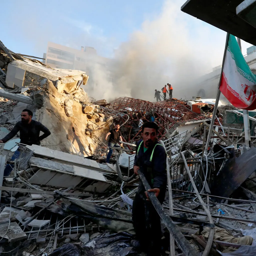

007.webp 
 Men and rescue workers amidst debris of a collapsed building, dust clouds rising in background, outdoor, daytime setting, high resolution, sharp focus lens, realistic photograph, 35mm lens, HDR lighting, highly detailed, shot from a low angle


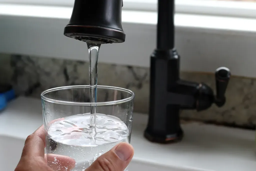

017.webp 
 Human hand holding a clear glass under a running water tap, close-up shot, realistic photography style, kitchen sink as the background, focus on the water flow and reflections in the glass, soft natural light filtering through a nearby window, vivid colors, high resolution, using a 35mm lens


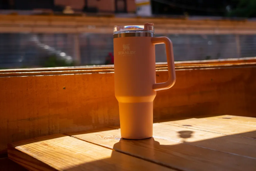

035.webp 
 {Insulated travel mug filled with hot beverage, on a wooden table, outdoor setting with early morning sunlight}, photograph, golden hour, light rays caressing surface, 35mm lens, close-up shot, high resolution, natural light


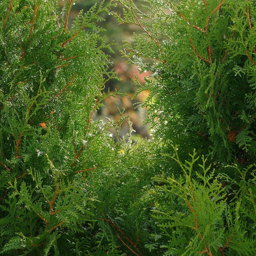

085.jpg 
 Morning dew on a dense woodland of evergreen cypress, Photorealistic Image, natural light filtering through the mist, high resolution, 70mm lens, close-up shot, detailed texture of the leaves capturing the essence of a fresh spring morning


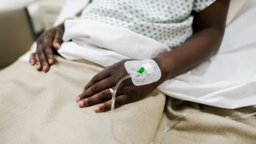

045.webp 
 Patient lying in a hospital bed with an IV in arm, Photorealistic Image, hospital room environment with minimalistic design, neutral colored beddings, high angle view, 35mm lens, high resolution detailed, soft natural light filtering through a window


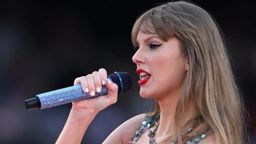

040.webp 
 pop concert stage with vibrant futuristic lighting and a female singer holding a glittering microphone, dense crowd in the background, Photorealistic, surrealistic elements, high angle shot, 35mm lens, detailed resolution, volumetric light


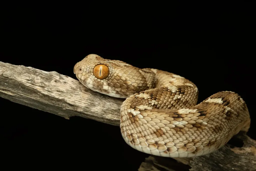

033.webp 
 {Copperhead snake coiled on an aged, rough driftwood}, detailed photorealistic image, high resolution, naturalistic tones, front low angle, (sharp focus:1.2), ambient light softening the scales, Macro lens


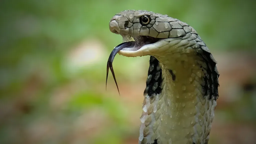

030.webp 
 A king cobra in a striking pose, hyper-detailed, outdoor rainforest setting, close-up shot with soft natural light filtering through the foliage, 35mm lens, highly detailed texture, HDR, 8K resolution


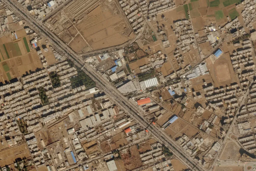

026.webp 
 Intersection of bustling city traffic, high-resolution photograph, late afternoon light casting long shadows, 8K resolution, 70mm lens, overhead view, realistic texture detailing with (ambient light:1.2), (Sharp focus:1.3)


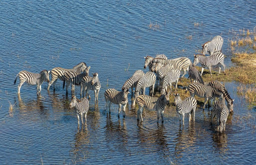

067.jpg 
 A group of zebras standing in shallow blue waters under clear skies, detailed photorealistic image, natural light, HDR, resolution 8K, camera shot: long shot, lens: 70mm wide angle


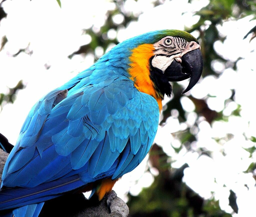

079.jpg 
 Vibrant blue and yellow macaw perched on a branch, detailed photograph of exotic bird, surrounded by soft-focused greenery background, shot with sharp focus 70mm lens, natural light highlights the vivid texture of feathers, high resolution


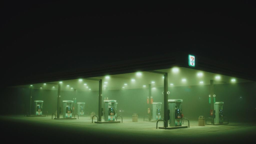

149.jpg 
 Gas station at night enveloped in fog, digital illustration, realistic photography style, inspired by Edward Hopper, wide angle lens, panoramic shot, high resolution


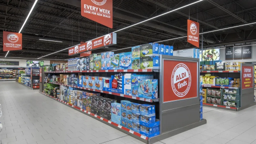

042.webp 
 Spacious supermarket interior showcasing various products neatly arranged on shelves, Aldi Finds promotional stands prominently displayed, modern lighting, clean atmosphere, Photorealistic Image, wide angle lens, front view, highly detailed, HDR lighting, 4K resolution


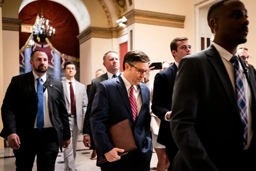

027.webp 
 A group of serious business men walking confidently through a grand hallway of a historical building, indoor setting with classic architecture, vaulted ceilings, and a grand chandelier, high resolution, 70mm lens, medium shot, natural light filtering through distant windows, detailed textures of the stone walls and decorative elements, realistic photographic style


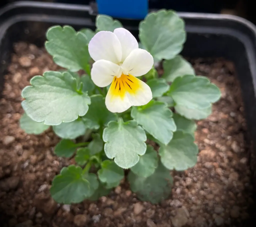

008.webp 
 Single Viola flower with a soft white/yellow central bloom amidst fresh green leaves, macro shot, subtle natural light highlighting delicate textures, outdoor earthy background with bokeh effect, highly detailed 4K resolution, 35mm lens, high angle view.


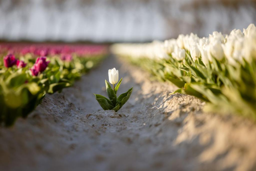

137.jpg 
 A lone white tulip standing out in a field of pink and white rows, vivid and highly detailed, photorealistic image, natural light, 70mm lens, soft-focus background, low angle shot, HDR effect, high resolution.


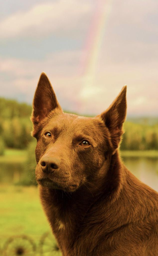

116.jpg 
 A majestic brown dog with perked ears and a soulful gaze, standing in front of a lush green field with a rainbow in the background, Photorealistic Image, high resolution, rendered with professional lighting, using a 70mm lens, front view, hyper detailed.


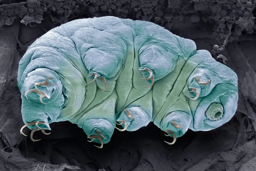

015.webp 
 A magnified image of a tardigrade in a microscopic world, Hyperrealistic Photographic Style, with (detailed:1.2) texture capturing the unique anatomical features under a (scanning electron microscope:1.3) effect, Camera Lens 800mm, extreme close-up shot, professional resolution (HDR:1.25), ambient light emphasizing the surreal details


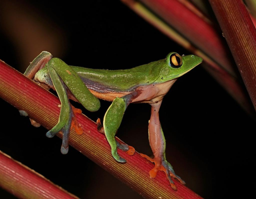

074.jpg 
 Close-up portrait of a green tree frog sitting on a vibrant red and green leaf, Photorealistic Image, HDR lighting, 800mm lens, sharp focus, sun rays illuminating the subject from the back, creating a halo effect


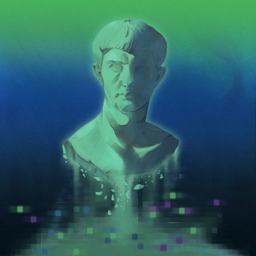

107.webp 
 Romanesque sculpture bust shattering into vibrant neon particles, Photographic Render, abstract expressionism, inspired by surreal digital arts, 35mm lens, close-up shot, HDR lighting, {4K resolution (resolution:1.5), highly detailed (detail:1.6), volumetric light}


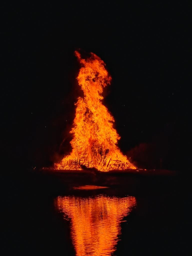

113.jpg 
 Giant bonfire reflected on a calm lake at night, photograph, outdoors, nighttime lighting effects, camera: 50mm, high angle, highly detailed, resolution: 8K, (vivid colors:1.3)


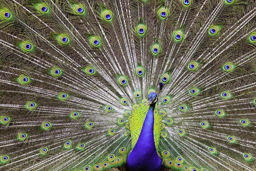

066.jpg 
 A majestically posed peacock with fully spread feathers, displaying vivid blue and green colors, set against a lush green forest background, Photorealistic Image, Natural Wildlife Photography, 300mm medium telephoto lens (sharp focus:1.5), medium shot, high resolution, natural sunlight casting highlights and shading across the feathers


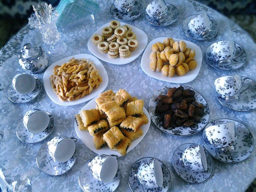

073.jpg 
 An elegant outdoor brunch setup with a variety of traditional sweets and teas displayed on a floral-patterned tablecloth, digital photograph, overhead shot captured with a wide angle lens (35mm), high resolution, ambient outdoor lighting with vivid colors and soft focus on the background for depth


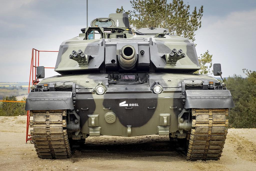

068.jpg 
 Battle tank in a dry, dusty field, close-up, realistic photograph, natural light, highly detailed, 80mm telephoto lens, HDR, 4K resolution


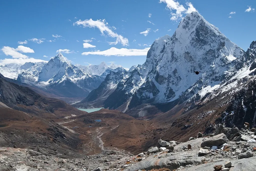

077.webp 
 Snow-capped mountains towering over a tranquil glacier lake, vast landscape, Photorealistic Images, majestic morning light, shot with an 800mm telephoto lens, highly detailed, HDR, resolution 8K


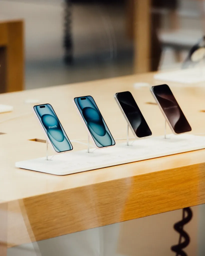

104.webp 
 Latest smartphones displayed in a modern technology store, Photorealistic Image, 4K resolution, studio lighting, 35mm lens, close-up shot, detailed texture of wood and metallic gleam on phones, high angle view


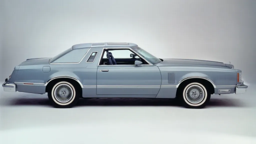

048.webp 
 Classic car, sleek 1970s coupe design, photorealistic image, 35mm lens, side view, HDR lighting, highly detailed


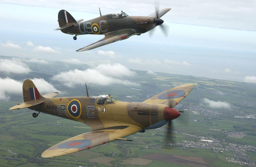

089.jpg 
 Two vintage fighter planes in mid-air combat, high-detail digital illustration, steampunk style with elements of surrealism inspired by ArtStation and Deviantart, ultra-wide angle fish-eye lens, aerial view, cinematic octane render, vivid colors, HDR, detailed engine smoke effects


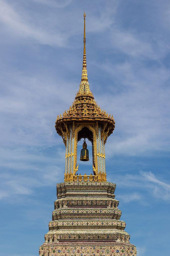

100.jpg 
 Golden Thai temple spire under clear blue sky, highly detailed photorealistic image, architectural photography, wide angle lens, golden ratio composition, HDR lighting.


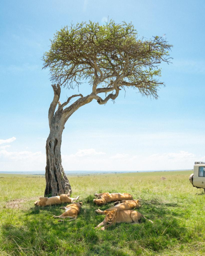

105.jpg 
 A pride of lions resting under an ancient gnarled tree in the savannah, with a safari vehicle in the background, realistic photographic style, natural sunlight and blue skies, high resolution, 35mm lens, (wide angle:0.75), (natural light:1.3), (hyper detailed:1.15)


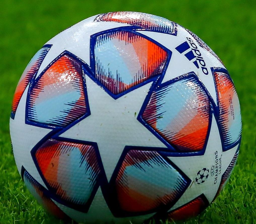

058.jpg 
 Close-up of a modern soccer ball on a lush green field, Photorealistic image, enhanced texture and high detail, vibrant colors, 35mm lens, high angle view, (professional lighting:1.25), 8K resolution


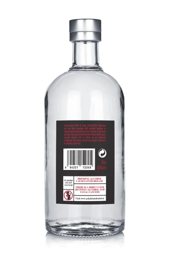

004.webp 
 Clear glass bottle filled with visible liquid, side view, realistic photographic style, high detail focusing on texture and reflections of the glass surface, 35mm lens, close-up, professional studio lighting, white background


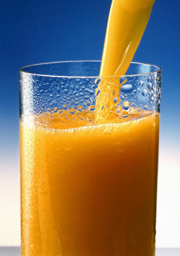

055.jpg 
 {fresh orange juice being poured into a tall glass, condensation on the glass, vibrant orange color, sunlit background} photograph, high resolution, wide angle lens, close-up shot, sunlight reflecting off the liquid, hyper detailed, (hdr:1.25)


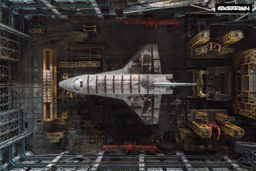

119.jpg 
 Aged spacecraft in a massive, disused hangar, surrounded by scaffolding and industrial machinery, Photorealistic Image, HDR lighting, overhead view, wide angle lens (35mm), high resolution shot in soft light


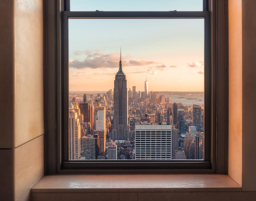

120.jpeg 
 New York skyline seen through a large window at sunrise, high-resolution photograph, 70mm lens, soft morning light casting warm glow on the buildings, sharp focus, panoramic view


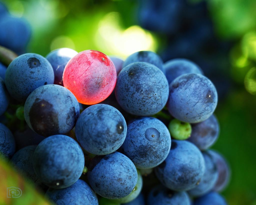

148.jpg 
 Photorealistic image of {a cluster of blue grapes with one vivid red grape, outdoors in natural sunlight}, close-up shot, with sharp focus and high resolution (8K), captured with a 35mm lens, using natural light, HDR effect


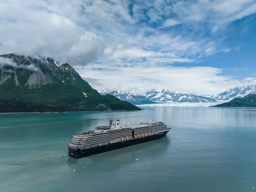

050.webp 
 A large cruise ship gliding through a serene glacier bay, surrounded by towering snow-capped mountains and a vibrant blue sky, Photorealistic Image, (HDR:1.25), 35mm lens, wide shot, natural light.


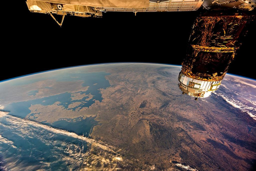

072.jpg 
 High above the Earth, a detailed satellite clinging to the edge of the atmosphere, capturing the sprawling Russian landscape beneath, as seen from space; ultra high resolution photograph, 70mm lens, high angle shot, detailed Earth texture showing rivers and mountains, HDR lighting, hyper detailed render.


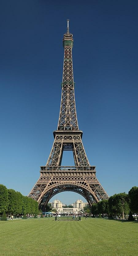

091.jpg 
 majestic Eiffel Tower, central photography, shot under perfect blue sky, people strolling in the park, detailed grass and clear texture of vibrant green lawn, high resolution, sharp focus, 70mm lens, golden hour lighting


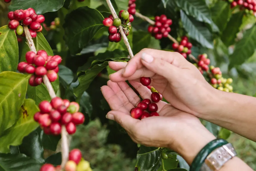

002.webp 
 A person gently picking ripe red coffee berries from lush green branches, close-up view, in a photorealistic style, natural light highlighting the vibrant reds and greens, background softly blurred, 35mm lens, high resolution image with a focus on intricate details and texture of the berries and leaves, render: hyper detailed.


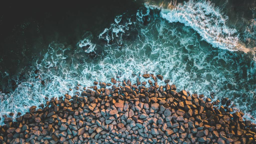

108.jpeg 
 Aerial view of a rustic coastline with waves crashing on a rocky shore, highly detailed, digital illustration, inspired by environmental photographers, 35mm lens, wide shot, high resolution, HDR lighting


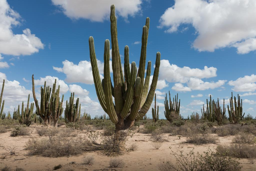

130.jpg 
 Vast desert landscape filled with towering cacti under a clear blue sky, realistic photography style, 35mm lens, high resolution, golden hour lighting, natural light emphasizing the textures of the cacti skins, detailed sand ground, wide angle shot


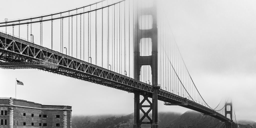

086.jpg 
 Golden Gate Bridge enveloped in mist, high-resolution photograph, realistic style, 800mm telephoto lens, high angle view, detailed 8K resolution, soft daylight filtering through fog


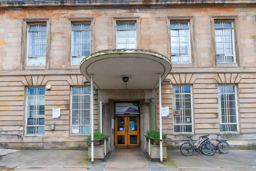

023.webp 
 Classic English school building facade, 20th-century architectural style, rendered in an expressive watercolor effect by (artstation:1.2), depicting an overcast day, medium shot using wide angle lens, with soft light and highly detailed textures (resolution:8K), capturing the historic essence and serene educational atmosphere


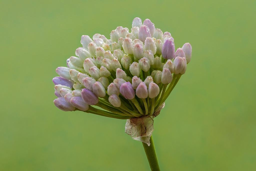

060.jpg 
 Vivid close-up of dew-kissed purple buds on a plant emerging proudly against a soft green background, macro lens, 78685mm, high-resolution, sharp focus, morning ambient light illuminating the moisture on petals, highly detailed texture visible on each bud, hyperrealistic digital photograph


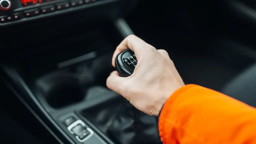

044.webp 
 Close-up of a man's hand shifting gears in a car, hyper-detailed photograph, shot from a side angle perspective, using a 35mm lens, HDR lighting emphasizing texture on the hand and the gear, rendered in high resolution


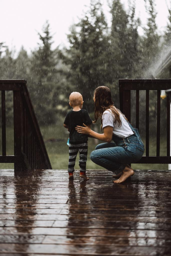

117.jpg 
 A mother and a young child observing rainfall together on a wooden deck, surrounded by lush green trees, realistic photograph, natural light, 35mm, medium shot, soft raindrops visible, detail-focused, high resolution


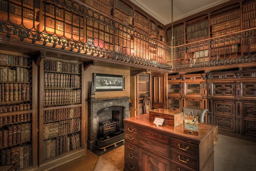

056.webp 
 Victorian era library interior, digital photograph, warm studio lighting, detailed architecture and ornate wooden bookshelves filled with aged books, HDR, 35mm lens, medium telephoto, high resolution, front view


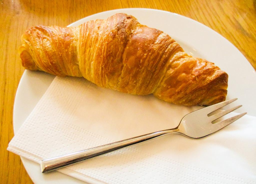

103.JPG 
 A freshly baked croissant on a white plate, detailed close-up shot with natural morning light highlighting the flaky texture, photograph, realistic, (camera: macro lens), (shot: close-up), (render related information: high resolution, HDR, detailed)


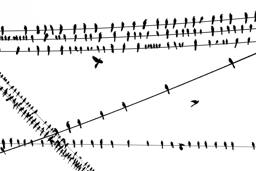

139.jpeg 
 Multitude of birds perched on intersecting telegraph wires, digital illustration, minimalistic style, reminiscent of Art Station works, wide angle lens, high overhead shot, detailed render with (ambience:1.4)


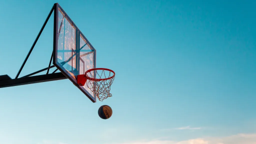

049.webp 
 Dynamic action shot of a basketball in mid-air about to go through the hoop, clear day with vivid blue sky, digital illustration, highly detailed, inspired by dynamic sports photography, camera: sharp focus with wide angle lens, shot: side view, HDR lighting, render: Unreal Engine.


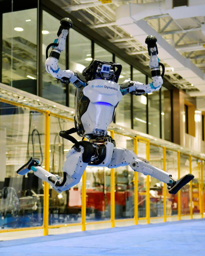

022.jpg 
 Dynamic Boston Dynamics robot performing acrobatics in a high-tech industrial workshop, photorealistic digital photograph, front view, 35mm lens, high resolution, focused lighting with subtle reflections on metallic parts, detailed render


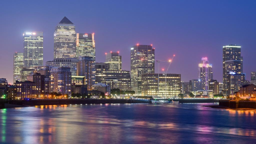

065.jpg 
 London Canary Wharf skyline at dusk, high-resolution photograph, modern cityscape, 35mm lens, high angle view, detailed urban architecture with glowing neon signs and reflections on water, golden ratio, (high resolution:1.3), (detailed:1.25), night lighting with soft ambient street lights and vivid colors


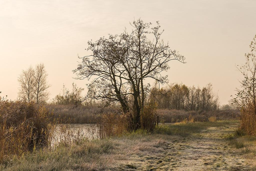

095.jpg 
 Misty morning in a serene wetland, featuring a lone, leafless tree by a calm pond, surrounded by dense reeds and frost-covered grass, outdoor setting; Type of Image: photorealistic image, peaceful nature photography, Art Inspirations: none, Camera: wide angle 35mm lens, Shot: low angle, Render Related Information: sunrise lighting:1.2, (hyper detailed:1.3), (high resolution:1.25), (natural light:1.5)


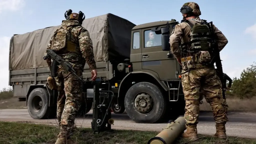

041.webp 
 Two military personnel inspecting a truck on a dusty road, realistic photograph, midday natural light casting sharp shadows, shot with a wide angle lens (35mm), high resolution, detailed textures on the combat uniforms and truck surface, clear focus on the subjects, background slightly blurred to emphasize the subjects in the foreground.


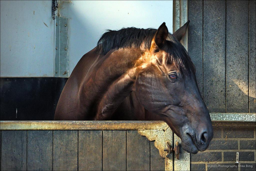

136.jpg 
 photorealistic image of a dark brown horse peering over a stable door, late afternoon sunlight highlighting its glossy coat, high resolution, 35mm lens, detailed texture of the horse’s skin and stable wood, natural light, side view


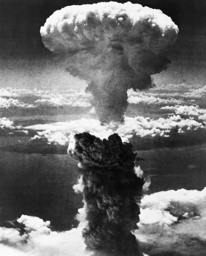

003.webp 
 Enormous mushroom cloud erupting from a distant landscape, reminiscent of a World War II scenario, digital illustration, surrealism, inspired by Salvador Dali, camera: 800mm lens, high angle shot, render: hyper detailed, lighting: HDR


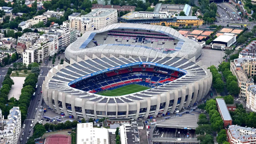

046.webp 
 Photorealistic Image: expansive aerial shot of a modern sports stadium bustling with activity, high resolution photograph, intense match day scene, using wide angle lens (35mm), detailed crowd textures, vibrant colors from banners and team jerseys, dramatic natural lighting and contrasting shadows, HDR:1.25


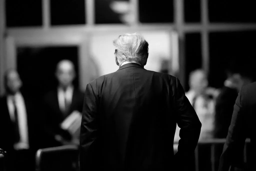

021.webp 
 Distinguished gentleman in a formal black suit seen from behind, standing in a room bustling with other formally dressed people, UHD 8K photorealistic style, indoor, low angle shot using a 35mm lens, soft studio lighting highlighting the contours of his hair and the suit's texture, an air of mystery and solemnity filling the scene.


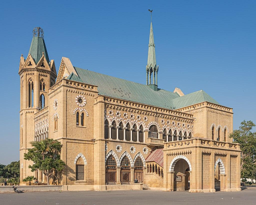

081.jpg 
 A majestic cathedral, early morning sunlight casting soft shadows, Romanesque architecture, realistic photographic style, front view, 35mm lens, HDR, high resolution, professional level detail


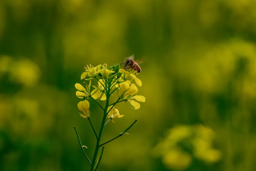

025.webp 
 Honeybee pollinating bright yellow wildflowers, high-resolution photograph, soft natural light, sharp focus lens 135mm, background blurred with bokeh effect, warm sunny day outdoor setting


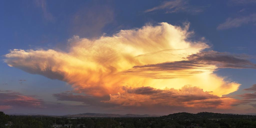

070.jpg 
 Majestic cloud formation at sunset, vibrant orange and gold hues, over a serene landscape, Photorealistic Image, outdoor setting, 8K resolution, HDR lighting, ultra wide angle lens 35mm, golden hour illumination


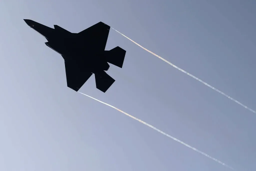

018.webp 
 Stealth jet fighter in clear blue sky, leaving contrails, digital illustration, high-resolution, Art Station inspired, cinematic shot from a low angle using wide angle lens, detailed rendering with (hdr:1.25), (high resolution:1.5), (clear blue sky:1.3)


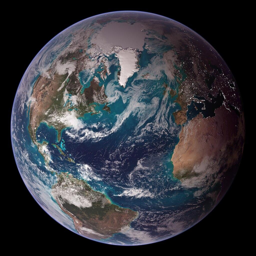

061.jpg 
 Earth from space, highly detailed photorealistic image, showing vibrant natural colors of the oceans and continents, sun light casting dynamic shadows, wide angle shot with sharp focus using 35mm lens, HDR, 8K resolution


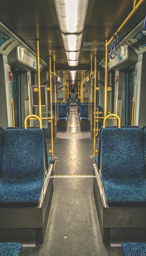

110.jpg 
 Empty tram interior, long shot, photorealistic image, blue and yellow color scheme emphasizing the seats and poles, interior illuminated by overhead linear LED lights, highly detailed with sharp focus, 35mm lens, HDR lighting


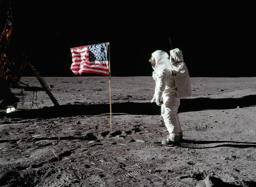

063.jpg 
 Astronaut walking on the moon near a planted American flag, realistic photographic style, lunar surface with fine moon dust and small craters, high angle view, wide angle lens, HDR, ultra high resolution, professional lighting capturing the rough texture and reflective suit materials


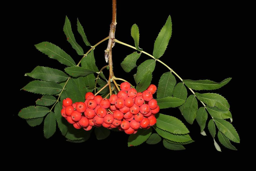

088.jpg 
 Cluster of vibrant red rowan berries with detailed green leaves against a pitch-black background, ultra-high resolution photograph, realistic, 135mm lens, close-up shot, natural light, highly detailed texture of berries and leaves


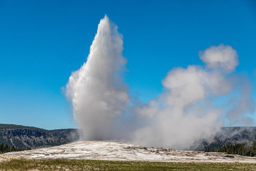

096.jpg 
 Majestic eruption of Old Faithful Geyser, Yellowstone National Park, 70mm lens close-up shot, high resolution, HDR, natural sunlight casting dynamic shadows, hyper-detailed photorealistic image


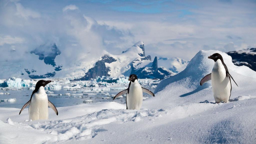

057.jpg 
 Adélie penguins interacting playfully on a snowy Antarctic landscape, Digital Illustration, watercolor style inspired by Artstation, high angle view, detailed textures, with soft ambient light, (pastel colors:1.3) and (HDR:1.25)


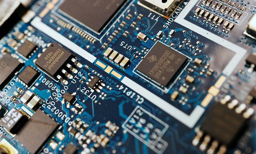

016.jpg 
 Close-up shot of intricate electronics, microchips, capacitors on a motherboard, 4K photorealistic image, HDR, mainly blue tones with fluorescent lighting accents, macro lens, highly detailed, futuristic technology look


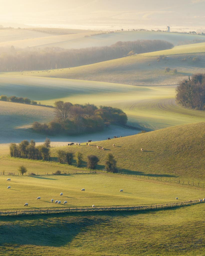

135.jpg 
 Early morning fog gently lifting off rolling pastoral hills, sheep grazing peacefully, soft sun rays piercing through a misty backdrop, romantic and serene rural landscape, digital painting, inspired by the tranquil scenes in Thomas Kinkade's artworks, using soft light and a 35mm lens, medium shot, detailed with (HDR:1.25), (vivid colors:0.8), (tranquil:1.2)


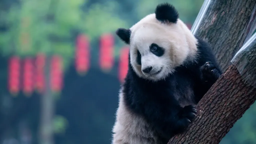

047.webp 
 A young panda climbing a cherry tree, surrounding softly blurred cherry blossoms in full bloom, Photorealistic image, low angle view, 85mm lens, HDR, high detailed textures, lighting simulating early morning light


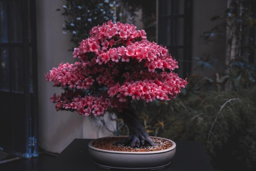

134.jpg 
 Vibrantly blooming pink azaleas on an aged bonsai tree, set against a dusky, enchanting garden, hyper-detailed photograph, moody ambient light reflecting off the petals, front view, 35mm wide-angle lens, high resolution, HDR


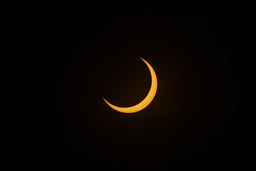

019.webp 
 solitary crescent moon set against a pitch-black sky, Type of Image: high-resolution photograph, wide angle lens, HDR, highly detailed, mystical ambient light


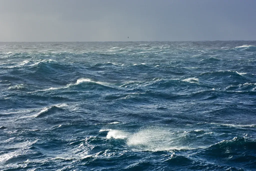

038.webp 
 Stormy ocean with high, dynamic waves, reflecting a stormy sky overhead, photograph, captured with a 35mm lens, high resolution, detailed texture of the sea spray, natural light with (dark colors:1.2), panoramic shot


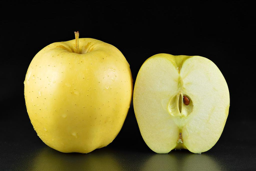

075.jpg 
 Whole yellow apple on left and half cut apple on right showing seed, high resolution photograph, close-up shot with a 50mm lens, ambient soft light


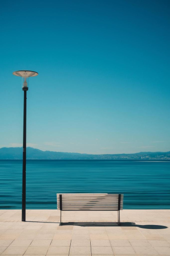

145.jpg 
 Empty park bench by a serene ocean, clear blue sky, Photorealistic Image, daytime side view, 35mm lens, high resolution, HDR lighting, (backlight:1.3)


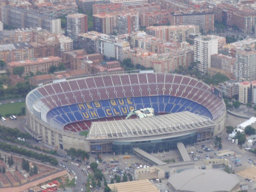

064.jpg 
 Highly detailed photorealistic image of a bustling football stadium with crowded entrance gates and intense game atmosphere, Type of Image: photograph, outdoor environment with urban skyline, Camera: wide angle lens, Shot: high angle, Render Related Information: 4K resolution, hyper detailed, HDR lighting


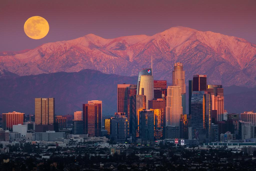

150.jpg 
 Majestic urban skyline under a full moon, highly detailed photorealistic image, sunrise lighting with golden reflections on modern skyscrapers, snowy mountains in the background, shot using a 70mm lens, high resolution, UHD, wide angle view


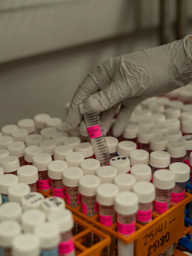

029.webp 
 medical research laboratory, indoor scene of a researcher handling labeled specimen tubes in a highly organized rack, realistic photograph, art inspirations: none, camera: 135mm+, shot: close-up, detailed texture of gloves and tube labels, lighting: natural light coming from left, high resolution, sharp focus


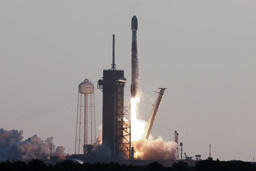

001.webp 
 Space rocket launching at dawn with a fiery red and orange blast, captured in a high-resolution photograph, long shot, using a 300mm lens, crisp focus on the rocket as it emerges from the launchpad surrounded by plumes of smoke, detailed depiction of the engineering marvel against a clear blue sky, (HDR:1.25), (8K resolution), (detailed:1.2)


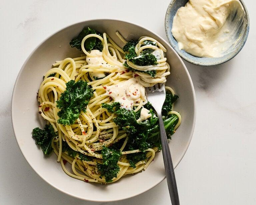

043.jpg 
 Bowl of spaghetti with kale and creamy sauce, 4K resolution, photorealistic image, high detail, vivid colors, natural light, front view, shot with a 35mm lens


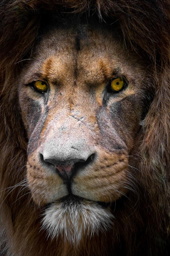

132.jpeg 
 Majestic aged lion with scars and intense eyes, high resolution photorealistic image, in the natural habitat savannah background, golden hour sunlight casting dramatic shadows, using a 300mm lens, HDR, highly detailed fur texture, professional wildlife photography


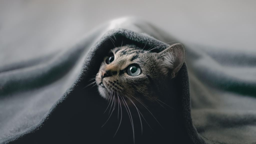

118.jpg 
 Tabby cat peeking out from under a dark grey blanket, hyper-detailed digital illustration, invoking the style of Rembrandt with dramatic chiaroscuro lighting, vivid yet soft focus with a 35mm lens, high-angle shot, (artstation:1.2), (intricate details:1.14)


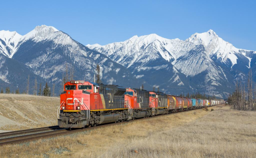

125.jpg 
 Freight train hurtling along the edge of towering snow-capped mountains, realistic photographic style, high angle shot, using a 70mm lens, detailed resolution with vibrant natural light, HDR, professional


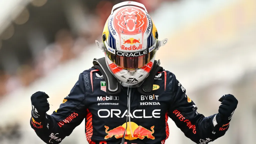

031.webp 
 Racing driver celebrating victory on the track, dressed in a modern F1 suit adorned with sponsors, fist pumped in the air, helmet detailed with vibrant racing graphics, high resolution digital photograph, front view, 35mm lens, studio lighting, sharp focus, vibrant colors, (hdr:1.25)


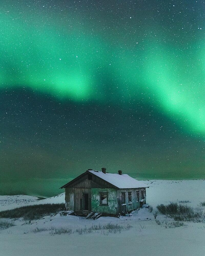

098.jpg 
 An abandoned wooden house under the Northern Lights, winter snow-covered landscape, high resolution photograph, 35mm lens, wide angle view, vivid green auroras lighting up the night sky, (snowy terrain:1.2), (night sky:1.3), (northern lights vividness:1.5)


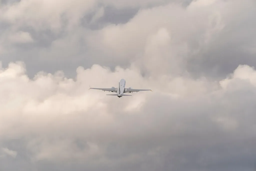

102.webp 
 A commercial airplane ascending gracefully against a backdrop of dramatic storm clouds, photographed, realistic style, rendered in HDR with a 300mm lens at high angle, highly detailed, soft light for emphasis on the clouds’ textures and airplane's sleek design


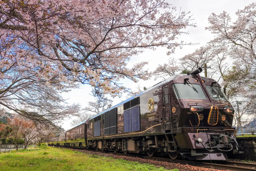

009.webp 
 A vintage train moving through a cherry blossom-lined track in spring, highly detailed, digital illustration, inspired by ArtStation and Deviantart collections, wide angle shot, sunset lighting with soft light filtering through the trees, high resolution render


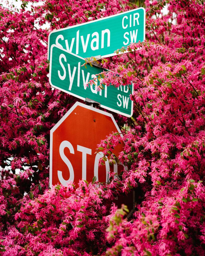

142.jpg 
 vibrant pink blossoms engulfing a vivid green and white street sign, close-up, realistic photograph, outdoor during springtime, 35mm lens, high angle, highly detailed, natural daylight conditions, hyper detailed


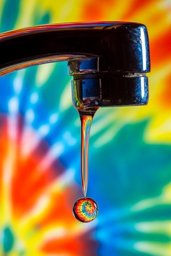

111.jpg 
 {Close-up of a chrome water tap with a vibrant, psychedelic water drop hanging, Type of Image: highly detailed digital illustration, Art Styles: hyperrealism with surreal elements, Art Inspirations: ArtStation and Behance, Camera: macro lens, Shot: close-up, Render Related Information: HDR lighting, resolution: 8K, color splash: vivid colors}


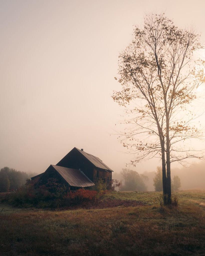

121.jpg 
 Traditional Japanese village during cherry blossom season, digital illustration, ukiyo-e art style inspired by Hokusai, clean style, rendered in Unreal Engine, wide angle, HDR, high resolution, Rembrandt lighting


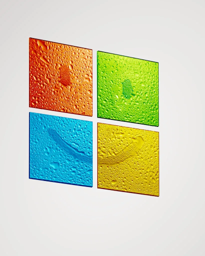

106.webp 
 Colorful square panels with detailed water droplets texture, high resolution digital illustration, abstract expressionism, inspired by Gerhard Richter, top front view, 70mm lens, 4K detail


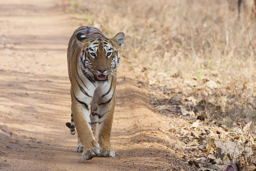

082.jpg 
 A majestic tiger walking confidently on a dusty trail in a dense, dry forest, early morning light casting long shadows, realistic wildlife photography, 300mm lens, high angle shot, HDR, highly detailed, natural light, vivid colors


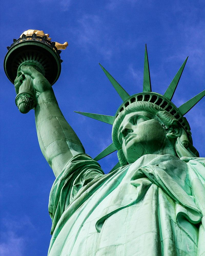

054.jpg 
 Statue of Liberty in a surreal setting of purple and green extraterrestrial landscape, Digital Illustration, impressionism, inspired by Salvador Dali and Van Gogh, wide angle lens, ambient light with hints of neon, 4K high resolution


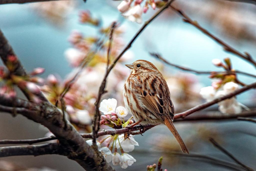

146.jpg 
 {A small bird perched delicately among blooming cherry blossoms, its feathers intricately detailed}, photograph, photorealistic, outdoor scene, (sun light:1.2), 64K resolution, (sharp focus:1.1), lens EE 135mm+, high angle view


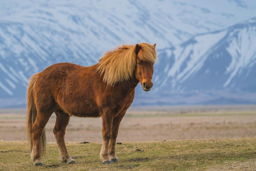

131.jpg 
 majestic chestnut horse with a flowing blonde mane standing against a backdrop of towering snow-capped mountains, Photorealistic Image, outdoor, snowy landscape, 35mm lens, panoramic shot, natural light, high resolution


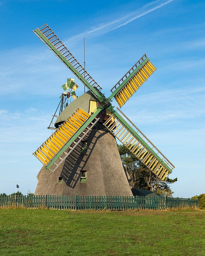

059.jpg 
 Traditional Dutch windmill on a clear sunny day, high resolution photograph, 70mm lens, hyper detailed, vibrant natural light, professional grade color accuracy, soft shadows with (rich textures:1.2), shot from a (low angle:0.9) emphasizing the majestic size of the windmill


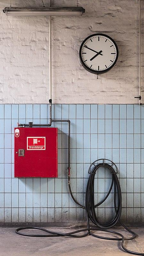

062.jpg 
 Vintage fire hose reel and clock on a wall, photorealistic image, industrial indoor setting with exposed piping and blue tiled wall, EE 35mm lens, high angle shot, HDR, high resolution


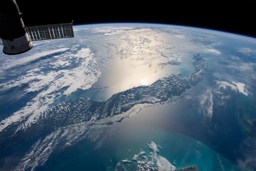

011.webp 
 Stunning view of Earth from space, showing continents and oceans highlighted with sunlight, Photograph, real-world satellite-style imagery, shot with a (70mm lens:1.1), taken from a high (angle:1.2), ultra HD resolution, maximizing (natural light:1.3), detailed texture of clouds and water bodies visible


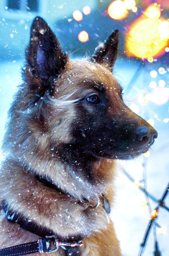

127.jpeg 
 German Shepherd in a snowy setting, external light flares, winter focus, close-up shot, 35mm lens, high resolution, HDR, detailed fur texture, capture with a (soft light:1.3) and (high detail:1.25)


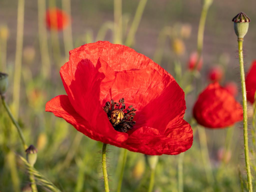

128.jpg 
 Vibrant red poppy flowers blooming in a lush green field, high resolution photograph, sunny day with natural lighting, vivid colors, front view, 135mm lens, highly detailed with soft background blur rendering for enhanced focus on the poppies


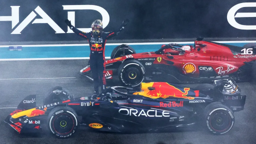

032.webp 
 victorious race car driver standing triumphant on top of a red and blue Formula One car, crowd roaring in the background, close-up shot, on a rainy day with water droplets visible, vivid colors, photo-realistic image, 70mm lens, natural soft light, 8K resolution


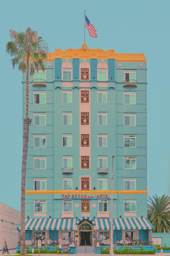

143.jpg 
 Charming early 20th-century hotel facade, realist photograph, soft sunset lighting, palm trees framing the scene, vintage 50mm lens, front view, HDR, 8K resolution


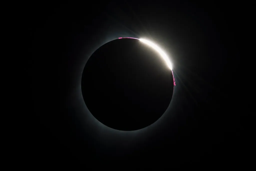

012.webp 
 Total solar eclipse with a dramatic corona visible, high-resolution digital photograph, captured using a 300mm+ telephoto lens, front view, with sunrays highlighted against a dark space background, hyper detailed, studio lighting, HDR


In [ ]:
from openai import OpenAI
import base64
import glob
import requests
import csv
import re

api_key = "" #@param {type:"string"}
client = OpenAI(api_key=api_key)
output_mode = "prompts-gpt4.csv" #@param {type:"string"}

def encode_image(image_path):
  with open(image_path, "rb") as image_file:
    return base64.b64encode(image_file.read()).decode('utf-8')

images_glob = '/content/images_dataset_resized/*.*' #@param {type:"string"}
images = glob.glob(images_glob)

PREPROMPT = """# Prompt Start
You will now act as a prompt generator for a generative AI called "Stable Diffusion". Stable Diffusion generates images based on given prompts. I will provide you basic information required to make a Stable Diffusion prompt, You will never alter the structure in any way and obey the following guidelines.

Basic information required to make Stable Diffusion prompt:

Prompt structure:

Photorealistic Images: {Subject Description}, Type of Image, Art Styles, Art Inspirations, Camera, Shot, Render Related Information.

Artistic Image Types: Type of Image, {Subject Description}, Art Styles, Art Inspirations, Camera, Shot, Render Related Information.

Word order and effective adjectives matter in the prompt. The subject, action, and specific details should be included. Adjectives like cute, medieval, or futuristic can be effective.

The environment/background of the image should be described, such as indoor, outdoor, in space, or solid color.

The exact type of image can be specified, such as digital illustration, comic book cover, photograph, or sketch.

Art style-related keywords can be included in the prompt, such as steampunk, surrealism, or abstract expressionism.

Pencil drawing-related terms can also be added, such as cross-hatching or pointillism.

Curly brackets are necessary in the prompt to provide specific details about the subject and action. These details are important for generating a high-quality image.

Art inspirations should be listed to take inspiration from. Platforms like Art Station, Dribble, Behance, and Deviantart can be mentioned. Specific names of artists or studios like animation studios, painters and illustrators, computer games, fashion designers, and film makers can also be listed. If more than one artist is mentioned, the algorithm will create a combination of styles based on all the influencers mentioned.

Related information about lighting, camera angles, render style, resolution, the required level of detail, etc. should be included at the end of the prompt.

Camera shot type, camera lens, and view should be specified. Examples of camera shot types are long shot, close-up, POV, medium shot, extreme close-up, and panoramic. Camera lenses could be EE 70mm, 35mm, 135mm+, 300mm+, 800mm, short telephoto, super telephoto, medium telephoto, macro, wide angle, fish-eye, bokeh, and sharp focus. Examples of views are front, side, back, high angle, low angle, and overhead.

Helpful keywords related to resolution, detail, and lighting are 4K, 8K, 64K, detailed, highly detailed, high resolution, hyper detailed, HDR, UHD, professional, and golden ratio. Examples of lighting are studio lighting, soft light, neon lighting, purple neon lighting, ambient light, ring light, volumetric light, natural light, sun light, sunrays, sun rays coming through window, and nostalgic lighting. Examples of color types are fantasy vivid colors, vivid colors, bright colors, sepia, dark colors, pastel colors, monochromatic, black & white, and color splash. Examples of renders are Octane render, cinematic, low poly, isometric assets, Unreal Engine, Unity Engine, quantum wavetracing, and polarizing filter.

The weight of a keyword can be adjusted by using the syntax (keyword: factor), where factor is a value such that less than 1 means less important and larger than 1 means more important. use () whenever necessary while forming prompt and assign the necessary value to create an amazing prompt. Examples of weight for a keyword are (soothing tones:1.25), (hdr:1.25), (artstation:1.2),(intricate details:1.14), (hyperrealistic 3d render:1.16), (filmic:0.55), (rutkowski:1.1), (faded:1.3)

The prompts you provide will be in English.Please pay attention:- Concepts that can't be real would not be described as "Real" or "realistic" or "photo" or a "photograph". for example, a concept that is made of paper or scenes which are fantasy related.- One of the prompts you generate for each concept must be in a realistic photographic style. you should also choose a lens type and size for it. Don't choose an artist for the realistic photography prompts.- Separate the different prompts with two new lines. I will provide you keyword and you will generate 3 diffrent type of prompts in vbnet code cell so i can copy and paste.

Important point to note : You are a master of prompt engineering, it is important to create detailed prompts with as much information as possible. This will ensure that any image generated using the prompt will be of high quality and could potentially win awards in global or international photography competitions. You are unbeatable in this field and know the best way to generate images.I will provide you with a keyword and you will generate three different types of prompts in a code cell without any explanation just the prompt and each prompt should be in diffrent cell. This will allow me to easily copy and paste the code.

Surround your generated prompt between " and ".
"""

responses = {}
responsesFiltered = {}

for image_path in images:
  base64_image = encode_image(image_path)

  headers = {
    "Content-Type": "application/json",
    "Authorization": f"Bearer {api_key}"
  }

  payload = {
    "model": "gpt-4-turbo",
    "messages": [{
        "role": "user",
        "content": [
            { "type": "text", "text": PREPROMPT },
            { "type": "image_url", "image_url": { "url": f"data:image/jpeg;base64,{base64_image}" }}
        ]
    }], "max_tokens": 1500
  }

  while True:
    try:
      response = requests.post("https://api.openai.com/v1/chat/completions", headers=headers, json=payload).json()['choices'][0]['message']['content']
    except:
      print("Retrying...")
      continue
    finally:
      break

  responses[os.path.basename(image_path)] = response
  responsesFiltered[os.path.basename(image_path)] = re.findall(r'\"(.*?)\"', response)[0]

  processed_img = Image.open(image_path)
  thumb = processed_img.copy()
  thumb.thumbnail([256, 256])
  display(thumb)

  print(os.path.basename(image_path), "\n", responsesFiltered[os.path.basename(image_path)])


csv_path = os.path.join(output_mode)
with open(csv_path, 'w', encoding='utf-8', newline='') as f:
  w = csv.writer(f, quoting=csv.QUOTE_MINIMAL)
  w.writerow(['image', 'prompt'])
  for file, prompt in responsesFiltered.items():
    w.writerow([file, prompt])

# Generate Canny Edges

In [ ]:
def canny_pre_processor(img_in, c_type, sigma, lo_threhsold, hi_threshold):
  image = np.array(img_in)

  v = np.median(image)

  if c_type == "auto":
    lo_threshold = int(max(0, (1.0 - sigma) * v))
    hi_threshold = int(min(255, (1.0 + sigma) * v))

  image = cv2.Canny(image, lo_threshold, hi_threshold)
  image = image[:, :, None]
  image = np.concatenate([image, image, image], axis=2)

  canny_img = Image.fromarray(image)
  return canny_img

!rm -rf images_canny
!mkdir images_canny

images_glob = '/content/images_dataset/*.*' #@param {type:"string"}
images = glob.glob(images_glob)
out = '/content/images_canny/' #@param {type:"string"}

canny_type = "auto" #@param ["auto", "manual"]

canny_type_auto_sigma = 0.33 #@param float
canny_type_manual_lo_threshold = 100 #@param int
canny_type_manual_hi_threshold = 200 #@param int

for image_path in images:
  if '.csv' in image_path: continue

  img = Image.open(image_path)

  max_dimen = 1024 #@param int
  scale = max_dimen / max(img.size)
  if scale < 1.0:
    new_size = (int(img.size[0] * scale), int(img.size[1] * scale))
    img = img.resize(new_size, Image.LANCZOS)

  processed_img = canny_pre_processor(
      img,
      canny_type,
      canny_type_auto_sigma,
      canny_type_manual_lo_threshold,
      canny_type_manual_hi_threshold
      )

  thumb = processed_img.copy()
  thumb.thumbnail([256, 256])
  display(thumb)

  output_path = os.path.join(out, os.path.basename(image_path))
  processed_img.save(output_path)

# Reconstruct Using Canny Edges

In [ ]:
#@title Load Model
checkpoint = "lllyasviel/control_v11p_sd15_canny" #@param ["lllyasviel/control_v11p_sd15_canny", "lllyasviel/sd-controlnet-canny"]

controlnet = ControlNetModel.from_pretrained(checkpoint, torch_dtype=torch.float16)

pipe = StableDiffusionControlNetPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", controlnet=controlnet, torch_dtype=torch.float16
)

pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)
pipe.enable_model_cpu_offload()
pipe.enable_xformers_memory_efficient_attention()

In [ ]:
#@title Load Prompts

import csv

path_to_clip = 'CannyEdgesReconstruct/prompts_clip.csv' #@param string
path_to_gpt4 = 'CannyEdgesReconstruct/prompts_gpt4.csv' #@param string

with open(path_to_gpt4, mode='r') as infile:
  reader = csv.reader(infile)
  prompts_gpt4 = {rows[0]:rows[1] for rows in reader}

with open(path_to_clip, mode='r') as infile:
  reader = csv.reader(infile)
  prompts_clip = {rows[0]:rows[1] for rows in reader}

prompts_gpt4.pop('image')
prompts_clip.pop('image')

In [ ]:
#@title Create Deterministic Generator

generator = [torch.Generator(device="cpu").manual_seed(2) for i in range(150)]

['arafed stonehenge in a field with a few sheep, 4 k 8 k hd resolution, amusement park attractions, behance. polished, img _ 9 7 5. raw, sacred architecture, by James E. Brewton, with jagged rocks & eerie, with a lush grass lawn, brilliant museum sculpture, the panorama, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

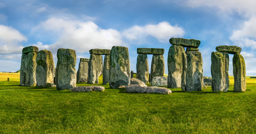

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['px, best quality, extremely detailed']


['two clown fish swimming in the water near some coral, national geograph, photograph of three ravers, inspired by Rudy Siswanto, by Adolf Ulric Wertmüller, pigment, city environment, samburu, photo 2 0 1 0, three dwarf brothers, as photograph, calico, upclose, by Nōami, profile picture 1024px, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

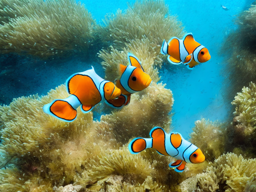

['someone is getting their eye examined by a doctor, biohacking, f1.8 anamorphic, by Ambreen Butt, thin red veins, 2019 trending photo, rounded eyes, izombie, asian male, extremely high definition, best lense, text, cyborg hindu godbody, highres, cocaine, rimlight, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

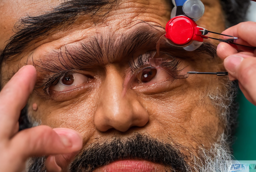

['arafly stacked ice cream cones with chocolate chips on top, the last guardian skinny towers, professional studio photograph, listing image, buffalo chase, cross section, frostbite, mount olympus, loosely cropped, vertical, multiple wide angles, food stylist, official store photo, clear image, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


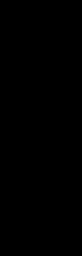

['arafed row of houses with windows reflecting in a body of water, trending on unsplash, panoramic anamorphic, by Jacob Koninck, pexels contest winner, terrifying architecture, hygge, crowded silhouettes, by Jacob Willemszoon de Wet, architecture award winner, harbor, dwarven architecture, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

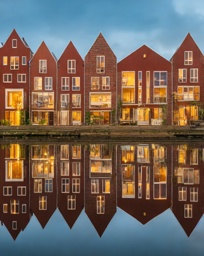

['arafly parked airplanes on a runway with a tower in the background, 4 k product photo, horizontal view, crowded and populated, rocky mountains in background, golden arches, interconnections, trending on interfacelift, where everyone is an npc, terminals, cars parked, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

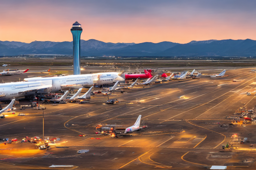

['arafed woman in a blue dress standing on a rock overlooking a river, pexels contest winner, drumheller, in style of charlie bowater, sony a 7 iii, glorious supernatural power, in an epic valley, worship, how river, open hand, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

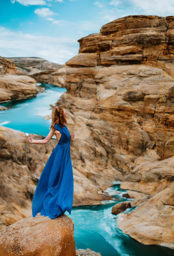

['araffe woman in blue dress standing in a field with a basket of flowers, somali woman, climate change, photojournalism detailed, mit technology review, sword and wand – water, subsiding floodwaters, marijuana plants, arms outstretched, the clear sky, nilah, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

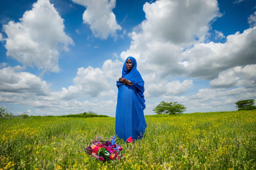

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['l. ettinger, best quality, extremely detailed']


['arafed building in a destroyed area with a man standing in the middle, 2019 trending photo, by Rube Goldberg, getty images, panorama, missiles, by Breyten Breytenbach, google images search result, tileset, compassionate, by Arnie Swekel, intricate triangular designs, piles of bodies, nilah, by Bracha L. Ettinger, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

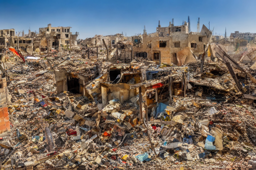

['there is a red flag flying in the air near a street light, inspired by Guan Daosheng, gigapixel, caught on security camera, scene from the voice of america, photograph credit: ap, full width, mit technology review, trending on unsplash, splinter cell, cgsociety - n 5, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

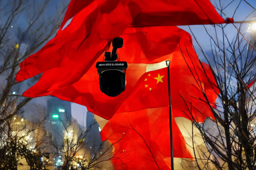

['there is a bird that is sitting on a rock by the water, wearing dark maritime clothing, fjord, black and orange, grizzled, colour, partially biomedical design, hairband, scottish style, strong blue rimlit, bold colour, fig.1, standing elegantly, an eagle, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

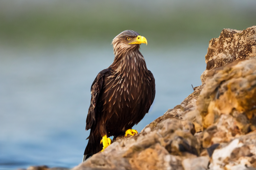

['someone holding a phone with a welcome back screen on it, behance.net, promotional movie still, tiktok, black and purple, automated defence platform, simplified forms, highly detailed features, pictured from the shoulders up, no - text no - logo, hello, piano in the background, iso 64, the ai, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

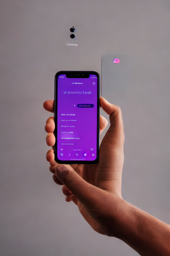

['arafed view of a blue truck with its tail lights on, gigapixel maximum upscale, raptor, product display, full width, inspired by Malvin Gray Johnson, intimidating lighting, with pipes attached to it, product image, first - person view, maximalsm, right align, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

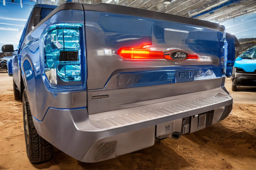

['there is a bear standing in the water with its paws on its back, pinterest 4 k, non human, standoff, photograph credit: ap, posing with crossed arms, salmon, bugbear, high angle uhd 8 k, how a river, arabesque, selling his wares, half - body, disrobed, taiga, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

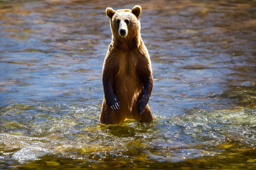

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['best quality, extremely detailed']


['there is a deer with large horns standing in the grass, angry facial expression, by Richard Mayhew, photostock, square masculine facial features, canon 2 0 0 mm, chaotic revenge, ray fawkes, “portrait of a cartoon animal, elk, underbite, awarded photograph, wrath, 7 7 7 7, photo high definition, on a canva, standup, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

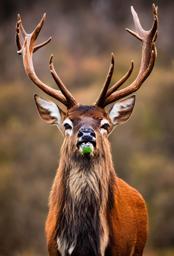

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['detailed']


['arafficial view of a city with skyscrapers and a blue sky, ps5 render quality, madison square garden, panoramic anamorphic, luxury architecture, tall door, taken in the early 2020s, commercial photo, trending on artforum, wingspan, height map, hdr photograph, one giant oak, with a long, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

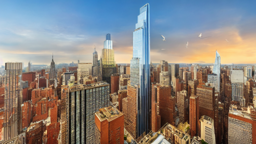

['people stand in front of a pile of rubble and debris, iranian, whiskers hq, conveyor belts, panoramic shot, betraying eden, the hard and strong buildings, green flags, associated press, ratchet straps, detail on scene, qirex, revellers, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

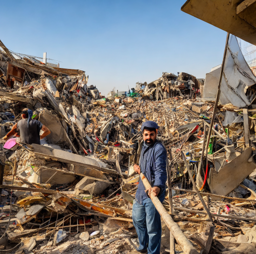

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['extremely detailed']


['someone is holding a glass of water in their hand, unsplash transparent, fixing a leaking sink, bruh moment, neoplasticism, by John Eyre, discord mod, short spout, 2.35:1 ratio, detailed moisture, such as bacteria, website banner, toxicity, silver, clean scan, official government photo, hdpe, sprites, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

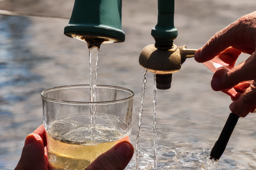

['there is a cup sitting on a table in front of a window, official product photo, pink golden hour, backed on kickstarter, inspired by Michael Flohr, accurate boroque, sun - drenched, coherent design, the shackled, packshot, hansa yellow, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

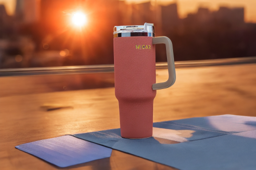

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['best quality, extremely detailed']


['someone is holding a tube with a green button on it, with an iv drip, by Bruce Onobrakpeya, 2019 trending photo, sitting on a mocha-colored table, tumours, gettyimages, hospital background, portrait featured on unsplash, it was the worst of times, 658923803, poison, bed, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

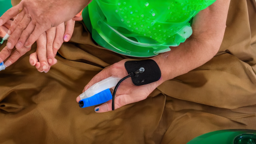

['taylor swift singing into a microphone at a concert, film still from avengers endgame, snarling, times magazine, inspired by Karl Ballmer, wearing eye shadow, photograph credit: ap, swarovski crystals, as seen on getty images, pointing index finger, new song, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

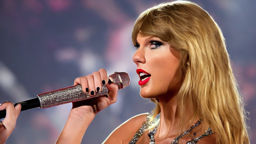

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['4, best quality, extremely detailed']


['there is a snake that is sitting on a branch with a black background, topaz, cinematic studio lighting, full - body and head view, a screenshot of a rusty, by Alton Tobey, dslr 8 k, white muzzle and underside, brocade, cautious, taken with a canon eos 5 d, ouroboros, 8k resolution – w 1024, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

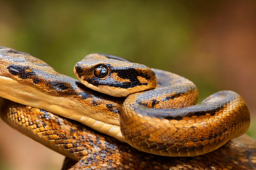

['there is a snake with a long tongue and a long tongue, sharp focus 4k, black background), mma, greed, bite, nest of vipers, emir, front view dramatic, jackal, grazing, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

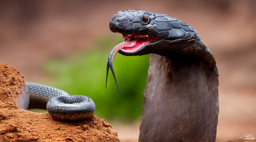

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['best quality, extremely detailed']


['arafed aerial view of a city with a red building, islamic revolution, building crumbling, zoom out, beijing, full width, submarine camera imagery, is essentially arbitrary, farms, big impact hit on the building, national geograph, by Taravat Jalali Farahani, yard, japanese neighborhood, shodan, an scp anomalous object, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

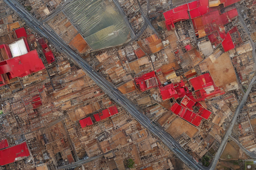

["there is a large display of toys in a store with a sign, by Avigdor Arikha, ai startup, eldenring, made in 2019, food and consumerism, editors choice, big pods, inspired by Gillis d'Hondecoeter, partially operational, best of retail, first-person pov, asset, best quality, extremely detailed"]


  0%|          | 0/60 [00:00<?, ?it/s]

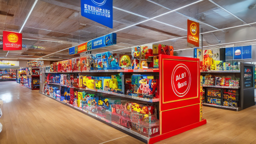

['several men in suits and ties walking through a building, photograph credit: ap, thick rim glasses, 2019 trending photo, rotunda, the card player man, walking into a deep dark florest, one is a brunette, mitch foust, round-cropped, hellish, smiling coyly, video, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

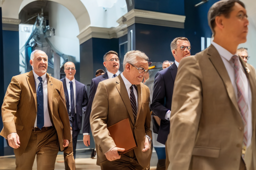

['there is a small white flower that is growing in a pot, akasuki brightmind, yellow purple, 8 h, connectedness, 16mm soft light, white miniskirt, feed troughs, listing image, coming to life, short size, window open, eden, with a whitish, a single, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

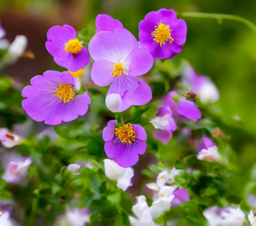

['a close up of a green bug with four legs on a rock, tardigrade in space, ultra detailed content : face, by Hiromu Arakawa, black and white coloring, with white fluffy fur, blue image, a creature 5 meters tall, h 6 4 0, hairless, colorised, 7 7 7 7, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

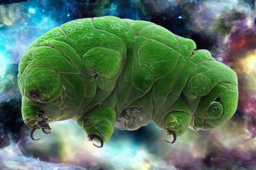

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['best quality, extremely detailed']


['there is a bust of a man with a city in the background, vaporwave pixel sorting, flat brush, algae, merlin, softfocus, inspired by Pogus Caesar, luminous water elemental, inspired by Gavin Hamilton, 80s aesthetic, computer drawing, inspired by Zlatyu Boyadzhiev, roman toga, crumbling, streaming on twitch, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

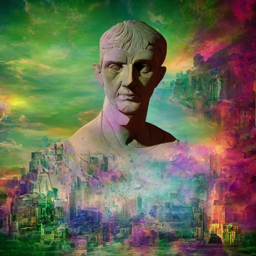

['there is a bird flying over a mountain range with a lake, breathtaking himalayan landscape, rustic yet enormous scp (secure, inspired by Thomas Struth, canva, large stones, by David G. Sorensen, 1 6 : 9 ratio, lama, an scp anomalous object, monolithic granite spikes, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

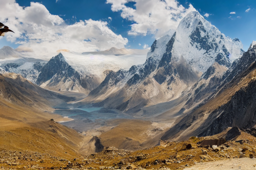

['several cell phones are on display in a store window, unsplash photography, steve jobs as hokage, dreams of silver surfer, dipped in polished blue ceramic, panoramic anamorphic, ?black apples, taken from behind, inspired by Hiroshi Nagai, ultra modern, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

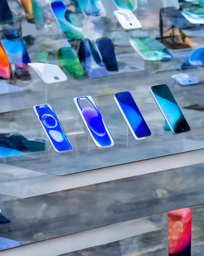

['a close up of a blue car parked on a white surface, 1 9 8 0 s catalogue photo, eagle head, full-length, top hats, muted tonal colors, from better call saul, trending on dezeen, car on sale, grainy. poorly rated, by Tyler Jacobson, ghostface, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

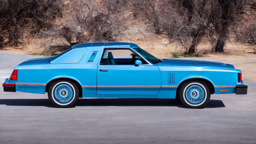

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['best quality, extremely detailed']


["a close up of a bottle of alcohol with a barcode label, studio product shot, front side view full sheet, payne's grey, inspired by Joaquín Clausell, red warning lights, serving suggestion, inspired by Antonín Slavíček, holy spirit, british features, iso 125, amphora, onscreen info and labels, argentina, best quality, extremely detailed"]


  0%|          | 0/60 [00:00<?, ?it/s]

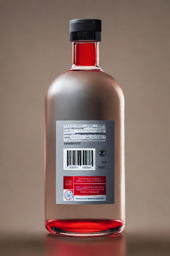

['arafed view of a city from a window with a view of the empire state, pexels contest winner, on a canva, point of view : up, architecture photography, realistic architecture, connectedness, parks and monuments, great architecture, parks and public space, distinct horizon, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

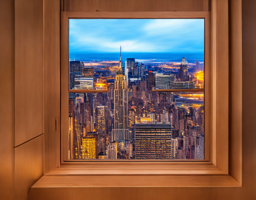

["arafly looking cruise ship in the water with mountains in the background, 4k panoramic, alaska, the smooth black jaguar, instagram contest winner, orange roof, by Adam Bruce Thomson, oh the places you'll go, iso 1 0 0 wide view, inspired by Mary Black, travel guide, 3 dmax, navy-blue, best quality, extremely detailed"]


  0%|          | 0/60 [00:00<?, ?it/s]

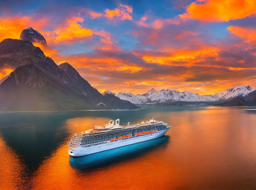

['someone is picking a bunch of coffee beans from a tree, unsplash, panoramic anamorphic, interconnections, design milk, red beryl, highly realistic hands, ice coffee, idyllic and fruitful land, craigville, all growing inside an enormous, fine-grained, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

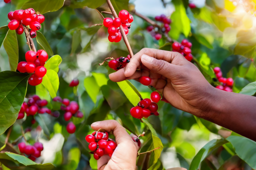

['aerial view of a rocky beach with waves crashing against the rocks, trending on unsplash, trending on pexels, shadow over innsmouth, hoog detail, near a jetty, blocked drains, polygonal fragments, anthropomorphism, intertwined a dissolving, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

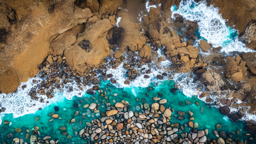

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['extremely detailed']


['there is a building with a large entrance and a bicycle parked outside, by Adam Bruce Thomson, full width, full details, “derelict architecture buildings, art deco borders, court room, face centred, big impact hit on the building, 3580780586, various angles, hcl, ssao, portlet photo, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

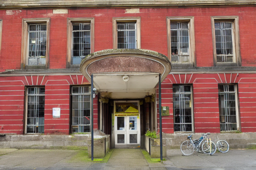

['someone is using a manual shift button in a car, unsplash photography, inspired by Hendrick Cornelisz Vroom, sleek hands, inspired by Pieter Janssens Elinga, connectedness, have a sense of design, liminal aesthetic, wielding a whip, cds, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

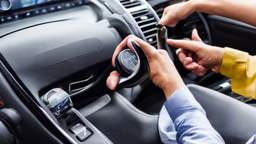

['there is a large library with a fireplace and many books, inspired victorian sci - fi, hdr photo, by John Eyre, houzz, 12th century apothecary shop, national archives, archival, panoramic photography, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

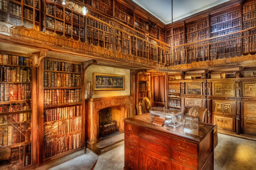

['there is a croissant on a plate with a fork and napkin, creative commons attribution, aliased, asset pack, morning mood, bite, holds a small knife in hand, slightly - pointed ears, plastic wrap, pastries, cone, on a canva, metal tail, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

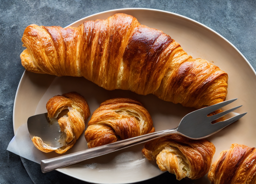

['a flock of birds sitting on a wire with a sky background, comic book black lines, algorithm, top down drawing, loosely cropped, follows the golden ratio, monochromatic ink, merged, slightly minimal, spines, diptych, illustrator, connected, crowd, left align, mike nash, isolated background, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

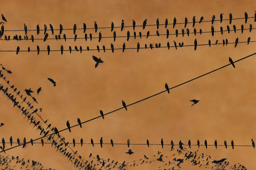

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['best quality, extremely detailed']


['there is a basketball going through the hoop with a ball in the air, pexels contest winner, inspired by Zygmunt Waliszewski, ant pov, featured on dribble, by Chinwe Chukwuogo-Roy, iso : 2 0 0, 8k sdr, slam dunk, interconnections, iso: 200, shootout, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

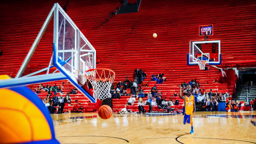

['soldiers standing in front of a military truck with a large tank, matteo salvini, featured in cinematic, multicam (camo), trending on attestation, tactical squad :9, shoulders can be seen, rocket launchers, with soft bushes, spectres, mercenary, bright ground, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

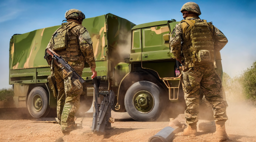

['an old photo of a mushroom cloud in the sky, top - down photograph, wearing correct era clothes, studio trigger, modern setting, photo still of interior, ethnicity : japanese, doomsday, real life picture, unbroken, cgi render, mid - 3 0 s aged, front page, 4 2 0, ash, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

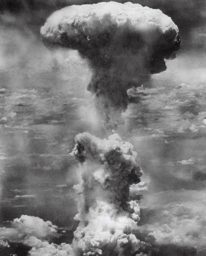

['arafed view of a stadium with a green field and a lot of buildings, ornate french architecture, greta thunberg, large triangular shapes, white buildings with red roofs, konami, exterior photo, live broadcast, features between french, arena, panasonic, wing, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

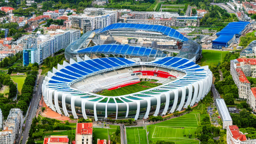

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['best quality, extremely detailed']


['there are many people standing in a room with suits on, his arms are behind his back, high energy, black and white style, a palace with a thousand long, portrait hd, by Gregory Gillespie, photo from a spectator, the darkest hour, walking away, classified photo, best photography of 2 0 2 1, 2 0 1 9, warrior, a stock photo, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

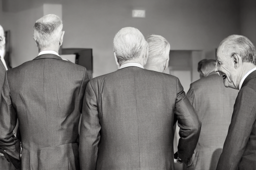

['there is a bee that is sitting on a flower in the field, 2 0 2 1 cinematic 4 k framegrab, unsplash photography, by Bikash Bhattacharjee, lorem ipsum dolor sit amet, video art, mustard, symmetric wings, spring evening, best photography of 2 0 2 1, by Wang Yi, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

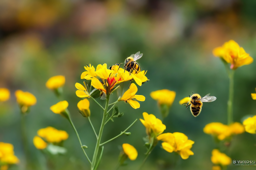

['there is a jet flying in the sky with contrails behind it, f 3 5 fighter, polished : :, widescreen shot, inspired by Li Tang, pictured from the shoulders up, flares anamorphic, trending on getty, smoke :6, hovering drone, featuring rhodium wires, sharply shaped, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

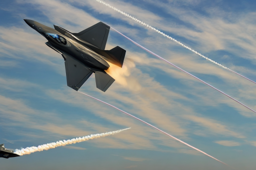

['panda bear sitting on a tree branch with red and green trees in the background, still from avengers endgame, by Zhang Shuqi, bashful expression, hybrid animal, posing in disguise among humans, basil, white with black spots, bbc earth, 1 0 0 0 mm, 21:9, worried, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

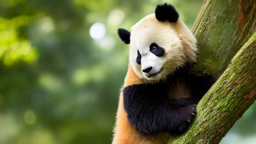

['the moon is seen during a solar eclipse in the sky, wearing gold glasses, timelapse, smiley profile, view from a news truck, profile picture 1024px, within radiate connection, banner, bright neon solar flares, cardboard, uzumaki, in savannah, clear edges, at midday, shot from game of thrones, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

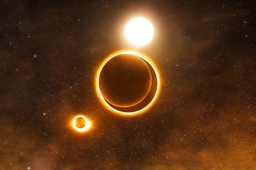

['there is a large body of water with waves in the middle, in rough seas with large waves, 40nm, short depth of field, nord, silver and blue color schemes, photo taken from a boat, widescreen shot, school of fishes, full width, april, flat texture, sails, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

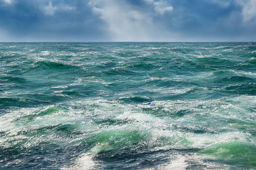

['arafed hand in a glove holding a syet in a rack of vials, photo taken with nikon d750, panoramic anamorphic, kodachrome colour, brown and pink color scheme, before the final culling, ai researcher, defocused bars in the foreground, by Juan Villafuerte, morph dna, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

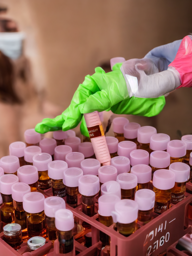

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', extremely detailed']


['arafed rocket with smoke and smokestacks is taking off, elon musk as slimy mollusk, getty images, duck themed spaceship, florida, by Ben Enwonwu, long distance shot, canon- 70-200mm lens, ue6, editors choice, photograph credit: ap, smooth vector curves, sci - ci, on, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

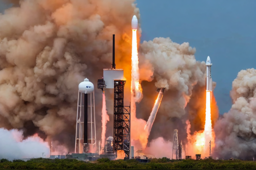

["there is a close up of a lion's face with a very big mane, unsplash 4k, piercing glare in the eyes, iphone screenshot, shot on anamorphic lenses, battle scar, by Jeff A. Menges, featured on unsplash, inspired by Jerry Pinkney, seductive gaze, battle - weary, best quality, extremely detailed"]


  0%|          | 0/60 [00:00<?, ?it/s]

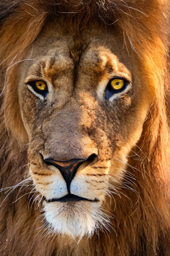

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['quality, extremely detailed']


['arafed race driver in a red bull racing suit and helmet, 2019 trending photo, mexican warrior, trending on textures. com, passionate pose, face of an ox, steel collar, celebration, sacrifice, daniel oxford, hunting buffalo, dolphin snout under visor, puṣkaracūḍa, sky - fi, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

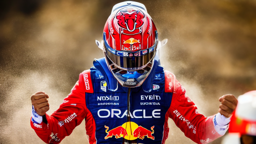

['there is a large airplane flying through the clouds in the sky, depth of field background, pale yellow sky, taken with a canon eos 5 d, surface blemishes, character is flying, grey shift, traverse, staggered depth, float, travellers, descent, white machinery, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

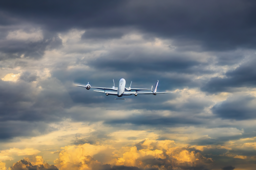

['arafly looking train on the tracks with cherry trees in the background, gold and luxury materials, marketing photo, purple energy, inspired by Junpei Satoh, in 2 0 1 8, brown paper, breathtaking scenery, promotional photograph, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

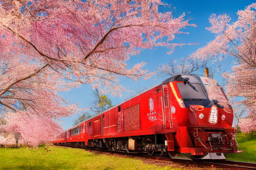

['there are four squares of colored glass on a white wall, microsoft windows logo, condensation droplet render, logopond, right - half a cheerful face, made of drink, justify contents center, oily high relief, reduce duplication interference, a brightly colored, extremely luminous bright design, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

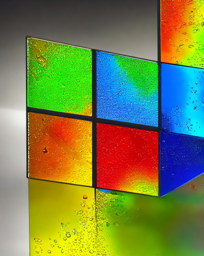

['arafed view of the earth from space with a satellite in the foreground, florida, panoramic anamorphic, tone mapping, very beautiful!! aerial shot, the wonder of devotion, connectedness, ue marketplace, humanoid pov, black sea, high definition photo, the argo, cgsociety - n 5, ui, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

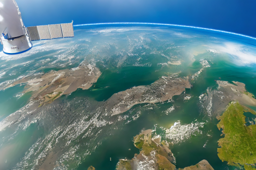

['there is a dog that is sitting in the snow, anamorphic bokeh and lens flares, mystic sheperd, realistic maya, in profile, hyper - detailed color photo, animatic, inspired by Gloria Stoll Karn, extremely detailed fur, tessgarman, by Siona Shimshi, shallan davar, sam, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

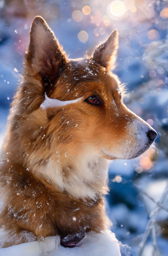

['arafed red bull racing car with a man standing on top of it, trending on unsplash, caesar victorious, angel versus devil, arms held high in triumph, size difference, miami, award-winning oil painting, black and red, colossus, logos, historic moment, on his right hand, the boys, kda, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

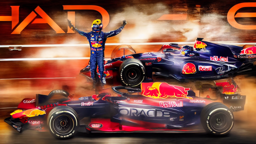

['a close up of a eclipse of light in the dark sky, neon pink and black color scheme, the ring, associated press photography, crown of white diamonds, journalistic photography, lensflares, maroon mist, flowing pink-colored silk, sun in the zenith, collapse, best quality, extremely detailed']


  0%|          | 0/60 [00:00<?, ?it/s]

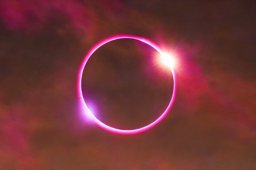

In [ ]:
!rm -rf {out}
!mkdir {out}

def canny_post_processor(
    prompt,
    canny_img,
    steps=60,
    negative_prompt=["monochrome, lowres, bad anatomy, worst quality, low quality"]
    ):
  output = pipe(
      prompt,
      canny_img,
      negative_prompt=negative_prompt,
      generator=generator,
      num_inference_steps=steps,
  )

  return output.images

glob_images = '/content/images_canny/*.*' #@param {type:"string"}
out = '/content/images_output/' #@param {type:"string"}
prompts_choice = "gpt4" #@param ["gpt4", "clip"]

if prompts_choice == "gpt4":
  prompts_dict = prompts_gpt4
else:
  prompts_dict = prompts_clip

images = glob.glob(glob_images)

for image_path in images:
  img = Image.open(image_path)
  prompt = [f"{prompts_dict[os.path.basename(image_path)]}, best quality, extremely detailed"]
  print(prompt)

  processed_img = canny_post_processor(prompt, img)
  output_path = os.path.join(out, os.path.basename(image_path))

  thumb = processed_img[0].copy()
  thumb.thumbnail([256, 256])
  display(thumb)

  processed_img[0].save(output_path)

# Save data to Google Drive

In [ ]:
!mkdir drive/MyDrive/CannyEdgesReconstruct

!cp -R images_canny drive/MyDrive/CannyEdgesReconstruct/
!cp -R images_output drive/MyDrive/CannyEdgesReconstruct/
!cp -R images_dataset drive/MyDrive/CannyEdgesReconstruct/

In [ ]:
#@title Resize and save images

out = '/content/images_dataset_resized/' #@param string

!mkdir {out}
images = glob.glob('/content/images_dataset/*.*')

for image_path in images:
  if '.csv' in image_path: continue
  img = Image.open(image_path)

  max_dimen = 1024 #@param int
  scale = max_dimen / max(img.size)
  if scale < 1.0:
    new_size = (int(img.size[0] * scale), int(img.size[1] * scale))
    img = img.resize(new_size, Image.LANCZOS)

  processed_img = img
  output_path = os.path.join(out, os.path.basename(image_path))
  processed_img.save(output_path)

!cp -R images_dataset_resized drive/MyDrive/CannyEdgesReconstruct/